# 1. Import libraries

In [ ]:
# For basic operations
import json
import numpy as np
import pandas as pd
from tqdm.notebook import trange, tqdm
from re import search
import warnings, scipy 
import time
import datetime
import re
import pprint as pp

# For scraping data from Google Play Store
from google_play_scraper import Sort, reviews, app

# For text pre-processing
import nltk
nltk.download('punkt')
nltk.download('stopwords')
from nltk.util import ngrams
import string as s
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.probability import FreqDist
from nltk.corpus import wordnet
from collections import Counter
from wordcloud import WordCloud
from pygments import highlight
from pygments.lexers import JsonLexer
from pygments.formatters import TerminalFormatter
import demoji
import emoji
from nltk.probability import FreqDist
from autocorrect import Speller

# For sentiment analysis
from textblob import TextBlob, Word
from nltk.corpus import wordnet as wn 
from nltk.sentiment.vader import SentimentIntensityAnalyzer # VADER
nltk.download('vader_lexicon') # VADER
from nltk.corpus import sentiwordnet as swn # SentiWordNet
import pysentiment2 as ps # HIV

# For topic modelling
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.cluster import DBSCAN
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.manifold import TSNE

# For data visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import networkx as nx
import seaborn as sns
from plotly.offline import iplot
from pylab import *

# 2. Scrape data from Google Play Store

## 2.1. Get app info

In [ ]:
# List of Apps and their packages to be collected. Here I choose some Apps under the category 'productivity'
app_packages = ['com.amazon.mShop.android.shopping',
    'com.tesco.grocery.view',
    'com.homeretailgroup.argos.android',
    'com.morrisons.atm.mobile.android',
    'com.marksandspencer.app',
    'com.boots.flagship.android']

app_infos = []

for ap in tqdm(app_packages):
    info = app(ap, lang='en', country='uk') # from the UK market
    del info['comments']
    app_infos.append(info)

In [ ]:
def print_json(json_object):
    json_str = json.dumps(
        json_object, 
        indent=2, 
        sort_keys=True, 
        default=str
    )
    print(highlight(json_str, JsonLexer(), TerminalFormatter()))
    
print_json(app_infos)

## 2.2. Get app reviews

In [ ]:
%%time

app_reviews = []

for ap in tqdm(app_packages):
    for rating in list(range(1, 6)):
        rvs, _ = reviews(
            ap,
            lang='en',
            country='uk',
            count=5000,
            sort=Sort.NEWEST,
            filter_score_with=rating
        )
        for r in rvs:
            # Sort reviews by the newest, group by app name
            r['sortOrder'] = 'newest'
            r['appId'] = ap

        app_reviews.extend(rvs)

## 2.3. Create a dataframe from scraped data

In [ ]:
app_df = pd.json_normalize(app_reviews)
#app_df.to_csv('20220325_app_df_raw.csv')

In [2]:
app_df = pd.read_csv('~/AdvancedDataModelling/20220325_app_df_raw.csv')

# 3. Data cleaning

## 3.1. Check missing values

In [3]:
# Create a function to calculate the percentage of null values in the dataframe
def check_missing_values(df, df_name):
    print(f'Percentage of null values in {df_name}')
    print('--------------------------------------------------')
    for i, col in df.items():
        count_null = col.isnull()
        percentage_null = round(count_null.sum() * 100.0 / np.shape(df)[0],2)
        print(f'Percentage of null values in column {i} = {percentage_null}%')

In [4]:
check_missing_values(app_df, "App review dataframe")

Percentage of null values in App review dataframe
--------------------------------------------------
Percentage of null values in column Unnamed: 0 = 0.0%
Percentage of null values in column reviewId = 0.0%
Percentage of null values in column userName = 0.0%
Percentage of null values in column userImage = 0.0%
Percentage of null values in column content = 0.07%
Percentage of null values in column score = 0.0%
Percentage of null values in column thumbsUpCount = 0.0%
Percentage of null values in column reviewCreatedVersion = 9.58%
Percentage of null values in column at = 0.0%
Percentage of null values in column replyContent = 93.87%
Percentage of null values in column repliedAt = 93.87%
Percentage of null values in column sortOrder = 0.0%
Percentage of null values in column appId = 0.0%


In [5]:
# Remove entries with missing content (reviews)
app_df = app_df[app_df['content'].notnull()]
app_df = app_df.reset_index().drop(columns={'index'})

# Remove "Unnamed: 0" (if you import the dataset from csv file)
app_df = app_df.drop(columns={'Unnamed: 0'})

## 3.2. Remove duplicates

In [6]:
app_df = app_df.drop_duplicates()

## 3.3. Add a column named `app_name` to identify each app

In [7]:
app_name = []
for i,col in app_df['appId'].items():
    if col == 'com.amazon.mShop.android.shopping':
        app_name.append('Amazon')
    elif col == 'com.tesco.grocery.view':
        app_name.append('Tesco')
    elif col == 'com.homeretailgroup.argos.android':
        app_name.append('Argos')
    elif col == 'com.morrisons.atm.mobile.android':
        app_name.append('Morrisons')
    elif col == 'com.marksandspencer.app':
        app_name.append('M&S')
    elif col == 'com.boots.flagship.android':
        app_name.append('Boots')
    else:
        np.nan
        
app_df['app_name'] = app_name

## 3.4. Extract date of the review

In [8]:
# Convert timestamp to yyyy-mm-dd (if the data was uploaded in a CSV format)
review_created_date = []
review_created_month = []
review_created_year = []
for i,col in app_df['at'].items():
    date = datetime.datetime.strptime(col, '%Y-%m-%d %H:%M:%S').strftime('%Y-%m-%d')
    month = datetime.datetime.strptime(col, '%Y-%m-%d %H:%M:%S').strftime('%Y-%m')
    year = datetime.datetime.strptime(col, '%Y-%m-%d %H:%M:%S').strftime('%Y')
    review_created_date.append(date)
    review_created_month.append(month)
    review_created_year.append(year)
    
app_df['review_created_date'] = review_created_date
app_df['review_created_month'] = review_created_month
app_df['review_created_year'] = review_created_year

In [ ]:
# Convert timestamp to yyyy-mm-dd (if the data was obtained using Google Play Scraper)
review_created_date = []
review_created_month = []
review_created_year = []
for i,col in app_df['at'].items():
    date = col.strftime('%Y-%m-%d')
    month = col.strftime('%Y-%m')
    year = col.strftime('%Y')
    review_created_date.append(date)
    review_created_month.append(month)
    review_created_year.append(year)
    
app_df['review_created_date'] = review_created_date
app_df['review_created_month'] = review_created_month
app_df['review_created_year'] = review_created_year

## 3.5. Remove entries older than 2021

In [9]:
app_df = app_df[app_df['review_created_year']>='2021']
app_df = app_df.reset_index().drop(columns={'index'})

# 4. Exploratory data analysis

## 4.1. Total reviews by month

In [10]:
# Create a function to calculate total reviews by month
def get_total_reviews_by_month(df, app_name):
    review_by_month_df = df[df['app_name']==app_name].groupby('review_created_month', as_index=False).size().rename(columns={'size':'total_reviews'})
    return review_by_month_df

In [11]:
# Count total reviews by month
amazon_review_by_month_df = get_total_reviews_by_month(app_df, 'Amazon')
tesco_review_by_month_df = get_total_reviews_by_month(app_df, 'Tesco')
argos_review_by_month_df = get_total_reviews_by_month(app_df, 'Argos')
morrisons_review_by_month_df = get_total_reviews_by_month(app_df, 'Morrisons')
marksandspencer_review_by_month_df = get_total_reviews_by_month(app_df, 'M&S')
boots_review_by_month_df = get_total_reviews_by_month(app_df, 'Boots')

In [12]:
# Visualise total reviews by month
total_review_by_month_fig = go.Figure(data=[
    go.Bar(name='Amazon', x=amazon_review_by_month_df['review_created_month'].astype(str), y=amazon_review_by_month_df['total_reviews']),
    go.Bar(name='Tesco', x=tesco_review_by_month_df['review_created_month'].astype(str), y=tesco_review_by_month_df['total_reviews']),
    go.Bar(name='Argos', x=argos_review_by_month_df['review_created_month'].astype(str), y=argos_review_by_month_df['total_reviews']),
    go.Bar(name='Morrisons', x=morrisons_review_by_month_df['review_created_month'].astype(str), y=morrisons_review_by_month_df['total_reviews']),
    go.Bar(name='M&S', x=marksandspencer_review_by_month_df['review_created_month'].astype(str), y=marksandspencer_review_by_month_df['total_reviews']),
    go.Bar(name='Boots', x=boots_review_by_month_df['review_created_month'].astype(str), y=boots_review_by_month_df['total_reviews'])
])

total_review_by_month_fig.update_layout(
    title='<b> Fig 1. Total reviews by month',
    xaxis_tickfont_size=12,
    xaxis=dict(
        title='Year',
        titlefont_size=14,
        tickfont_size=12
    ),
    yaxis=dict(
        title='Total reviews',
        titlefont_size=14,
        tickfont_size=12
    ),
    legend=dict(
        x=0,
        y=1.0,
        bgcolor='rgba(255, 255, 255, 0)',
        bordercolor='rgba(255, 255, 255, 0)'
    ),
    barmode='group',
    bargap=0.2,
    bargroupgap=0.05,
    plot_bgcolor='rgba(0, 0, 0, 0)',
    paper_bgcolor='rgba(0, 0, 0, 0)',
    uniformtext_minsize=8, uniformtext_mode='show'
)

total_review_by_month_fig.show()

## 4.2. Total reviews by rating

In [13]:
# Create a function to calculate total reviews by month
def get_total_reviews_by_rating(df, app_name):
    review_by_rating_df = df[df['app_name']==app_name].groupby('score', as_index=False).size().rename(columns={'size':'total_reviews'})
    return review_by_rating_df

In [14]:
# Count total reviews by rating
amazon_review_by_rating_df = get_total_reviews_by_rating(app_df, 'Amazon')
tesco_review_by_rating_df = get_total_reviews_by_rating(app_df, 'Tesco')
argos_review_by_rating_df = get_total_reviews_by_rating(app_df, 'Argos')
morrisons_review_by_rating_df = get_total_reviews_by_rating(app_df, 'Morrisons')
marksandspencer_review_by_rating_df = get_total_reviews_by_rating(app_df, 'M&S')
boots_review_by_rating_df = get_total_reviews_by_rating(app_df, 'Boots')

In [15]:
# Visualise total reviews by month
total_review_by_rating_fig = go.Figure(data=[
    go.Bar(name='Amazon', x=amazon_review_by_rating_df['score'].astype(str), y=amazon_review_by_rating_df['total_reviews']),
    go.Bar(name='Tesco', x=tesco_review_by_rating_df['score'].astype(str), y=tesco_review_by_rating_df['total_reviews']),
    go.Bar(name='Argos', x=argos_review_by_rating_df['score'].astype(str), y=argos_review_by_rating_df['total_reviews']),
    go.Bar(name='Morrisons', x=morrisons_review_by_rating_df['score'].astype(str), y=morrisons_review_by_rating_df['total_reviews']),
    go.Bar(name='M&S', x=marksandspencer_review_by_rating_df['score'].astype(str), y=marksandspencer_review_by_rating_df['total_reviews']),
    go.Bar(name='Boots', x=boots_review_by_rating_df['score'].astype(str), y=boots_review_by_rating_df['total_reviews'])
])

total_review_by_rating_fig.update_layout(
    title='<b> Fig 2. Total reviews by rating',
    xaxis_tickfont_size=12,
    xaxis=dict(
        title='Rating',
        titlefont_size=14,
        tickfont_size=12
    ),
    yaxis=dict(
        title='Total reviews',
        titlefont_size=14,
        tickfont_size=12
    ),
    legend=dict(
        orientation='h',
        x=0,
        y=1.1,
        bgcolor='rgba(255, 255, 255, 0)',
        bordercolor='rgba(255, 255, 255, 0)'
    ),
    barmode='group',
    bargap=0.2,
    bargroupgap=0.05,
    plot_bgcolor='rgba(0, 0, 0, 0)',
    paper_bgcolor='rgba(0, 0, 0, 0)',
    uniformtext_minsize=8, uniformtext_mode='show'
)

total_review_by_rating_fig.show()

# 5. Text pre-processing

## 5.1. Transform text to lowercase

In [16]:
def get_lowercase(col):
    lowercase_list = []
    for i in list(range(0, len(col))):
        text=col[i].lower()
        lowercase_list.append(text)
    return lowercase_list

## 5.2. Correct spelling

In [17]:
def get_correct_spelling(col):
    spell = Speller(lang='en')
    correct_spelling_list = []
    for i in list(range(0, len(col))):
        correct_spelling = spell(col[i])
        correct_spelling_list.append(correct_spelling)
    return correct_spelling_list

## 5.3. Replace emoji with its description to obtain better context

In [18]:
def get_emoji(col):
    emoji_list = []
    for i in list(range(0, len(col))):
        emoji = demoji.findall(col[i]) # Get list of all emojis that appear in the text
        emoji_list.append(emoji)
    return emoji_list

def replace_emoji_with_text(col):
    replaced_emoji_list = []
    for i in list(range(0, len(col))):
        replaced_emoji = emoji.demojize(col[i], delimiters=(" ", " ")) # Replaced emoji with its description
        replaced_emoji_list.append(replaced_emoji)
    return replaced_emoji_list

def get_emoji_flag(col):
    emoji_flag_list = []
    for i in list(range(0, len(col))):
        emoji_flag_list.append(bool(col[i]))
    return emoji_flag_list

In [19]:
%%time

# Apply the functions to handle emojis
app_df['content_lowercase'] = get_lowercase(app_df['content'])
app_df['content_lowercase_correct_spelling'] = get_correct_spelling(app_df['content_lowercase'])
app_df['emoji_list'] = get_emoji(app_df['content_lowercase'])
app_df['clean_content_no_emoji'] = replace_emoji_with_text(app_df['content_lowercase'])
app_df['emoji_flag'] = get_emoji_flag(app_df['emoji_list'])

CPU times: user 10min 50s, sys: 1.17 s, total: 10min 51s
Wall time: 10min 52s


## 5.4. Remove punctuation and digits

In [20]:
def remove_special_characters(col):
    clean_text_list = []
    for i in list(range(0, len(col))):
        clean_text=re.sub("(amazon)+","",col[i])
        clean_text=re.sub("(tesco)+","", clean_text)
        clean_text=re.sub("(testo)+","", clean_text)
        clean_text=re.sub("(boots)+","", clean_text)
        clean_text=re.sub("(argos)+","", clean_text)
        clean_text=re.sub("(args)+","", clean_text)
        clean_text=re.sub("(morrisons)+","", clean_text)
        clean_text=re.sub("(m&s)+","", clean_text)
        clean_text=re.sub("(app)+","", clean_text)
        clean_text=re.sub("(don't)+","do not", clean_text) # Replace "n't" with "do not"
        clean_text=re.sub("(can't)+","cannot", clean_text) # Replace "n't" with "cannot"
        clean_text=re.sub(r"\.(?=[^ \W\d])", '. ', clean_text) # Fix strings with no space between sentences
        clean_text=re.sub("('s)+"," is", clean_text) # Replace "'s" with "is"
        clean_text=re.sub("('ll)+"," will", clean_text) # Replace "'ll'" with "will"
        clean_text=re.sub("(/)+"," or ", clean_text) # Replace / with or
        clean_text=re.sub("[^\w\s]","", clean_text) # Remove punctuation
        clean_text=re.sub("(\\d)+","", clean_text) # Remove digits
        clean_text=re.sub("[^a-zA-Z0-9]+"," ",clean_text) # Remove non alphabetical characters, e.g. Arabic characters
        clean_text_list.append(clean_text)
    return clean_text_list

In [21]:
# Apply the function to remove punctuation and digits
app_df['clean_content'] = remove_special_characters(app_df['content_lowercase_correct_spelling'])

# Remove reviews written in non-alphabetical letters
app_df = app_df[app_df['clean_content']!=''].reset_index().drop(columns={'index'})

## 5.5. Remove single-character words

In [22]:
def remove_individual_letters(col):
    individual_letters = list(s.ascii_lowercase)
    individual_letters = [letter for letter in individual_letters if letter != 'i'] # Exclude 'i' because it is still a valuable information
    clean_text_list = []
    for i in list(range(0, len(col))):
        text = col[i]
        token = word_tokenize(text)
        clean_text = [word for word in token if not word in individual_letters]
        clean_text = " ".join(word for word in clean_text)
        clean_text_list.append(clean_text)
    return clean_text_list

In [24]:
# Apply the funciton to remove single-character words
app_df['clean_content'] = remove_individual_letters(app_df['clean_content'])

# Show the result
app_df[app_df['emoji_flag']==True][['content','clean_content']].head(5)

,content,clean_content
1,Worst service I have ever seen ordered some sa...,worst service i have ever seen ordered some sa...
37,not available in pakistan 😡😡😡,not available in pakistan
85,Amazon is horrible. I payed extra to have my p...,is horrible i played extra to have my package ...
96,March 13th 2022 I place 2 order for my grandda...,march th i place order for my granddaughter st...
105,It was very bad experience to use amazon to de...,it was very bad experience to use to deliver m...


In [25]:
app_df = app_df[app_df['clean_content']!=''].reset_index().drop(columns={'index'}) # Remove entries with missing reviews

## 5.6. Lemmatization

This is to get the basic dictionary form of the word. Due to morphology of words, a word may have various inflected forms, for example, “cat” and “cats”, “take”, “took”, and “taken”. (Shi, 2018)

In [26]:
def get_word_lemmatization(col):
    word_lemmatized_list = []
    for i in list(range(0, len(col))):
        sent = TextBlob(col[i])
        tag_dict = {"J": 'a', 
                    "N": 'n', 
                    "V": 'v', 
                    "R": 'r'}
        words_and_tags = [(w, tag_dict.get(pos[0], 'n')) for w, pos in sent.tags]    
        lemmatized_list = [wd.lemmatize(tag) for wd, tag in words_and_tags]
        lemmatized_string = " ".join(lemmatized_list)
        word_lemmatized_list.append(lemmatized_string)
    return word_lemmatized_list  

In [27]:
# Apply lemmatization to the clean_content column
app_df['clean_lemma'] = get_word_lemmatization(app_df['clean_content'])

## 5.7. Unigram tokenization including stopword removal

In [28]:
def get_unigram_tokens(col):
    content_token_list = []
    for i in list(range(0,len(col))):
        string = col[i]
        token = word_tokenize(string)
        content_token_list.append(token)
    
    # Remove stopwords from tokens
    stopwords_list = set(stopwords.words('english'))
    clean_content_token_list = []
    for content in content_token_list:
        clean_token = [token for token in content if not token in stopwords_list]  
        clean_content_token_list.append(clean_token)
    return clean_content_token_list

In [29]:
# Apply the function to get unigram tokens
app_df['clean_unigram_token'] = get_unigram_tokens(app_df['clean_lemma'])

## 5.8. Bi-gram tokenization without stopword removal

In [30]:
def get_bigram_tokens(col):
    bigram_token_list = []
    for i in list(range(0,len(col))):
        string = col[i]
        token = word_tokenize(string)
        bigram = list(ngrams(token, 2))
        bigram_token_list.append(bigram)
    return bigram_token_list

In [31]:
# Apply the function to get bigram tokens
app_df['clean_bigram_token'] = get_bigram_tokens(app_df['clean_lemma'])

## 5.9. Part-of-Speech (POS) tagging

In [32]:
def get_pos_tagging(col):
    pos_tag_list = []
    for i in list(range(0, len(col))):
        string = col[i]
        token = word_tokenize(string)
        pos_tag = nltk.pos_tag(token)
        pos_tag = [(t[1], t[0]) for t in pos_tag] # Swap element in tuple
        pos_tag = dict(pos_tag)
        pos_tag_list.append(pos_tag)
    return pos_tag_list

In [33]:
# Apply the function to obtain POS tagging
app_df['pos_tagging'] = get_pos_tagging(app_df['clean_lemma'])

# Create a dataframe that contains all POS taggings
pos_tagging_df = pd.DataFrame
pos_tagging_df = app_df['pos_tagging'].apply(pd.Series)

# Append the pos_tagging_df into the original dataframe
app_pos_tagging_df = pd.concat([app_df, pos_tagging_df], axis=1)

# 6. Sentiment analysis using python libraries

## 6.1. Sentiment analysis using VADER

In [34]:
def get_VADER_sentiment(df, col):
    # Declare VADER analyser
    analyser = SentimentIntensityAnalyzer()
    
    # Get compound score of each review in the dataset
    compound_score_list = []
    for i in range(0,len(df)): 
        sentiment_analyser = analyser.polarity_scores(col[i])
        compound_score = round(sentiment_analyser['compound'],2)
        compound_score_list.append(compound_score)
    
    # Interpret compound score
    sentiment_list = []
    for i in range(0,len(df)):
        if compound_score_list[i] <= -0.05:
            sentiment_list.append('Negative')
        elif compound_score_list[i] >= 0.05:
            sentiment_list.append('Positive')
        else:
            sentiment_list.append('Neutral')
            
    # Get polarity score and subjectivity score using TextBlob
    blob = [TextBlob(review) for review in col]
    polarity_list = [round(element.sentiment.polarity,2) for element in blob]
    subjectivity_list = [round(element.sentiment.subjectivity,2) for element in blob]
    
    # Append the result to the original dataframe
    df['VADERCompoundScore'] = compound_score_list
    df['VADERSentiment'] = sentiment_list
    df['VADERPolarityScore'] = polarity_list
    df['VADERSubjectivityScore'] = subjectivity_list
    
    return df

In [35]:
%%time

# Apply the function to obtain review sentiment using VADER
app_df = get_VADER_sentiment(app_df, app_df['clean_lemma'])

CPU times: user 14 s, sys: 408 ms, total: 14.4 s
Wall time: 14.6 s


## 6.2. Sentiment analysis using The Harvard General Inquirer

In [36]:
def get_HIV_sentiment_score(df):
    hiv4 = ps.HIV4()
    hiv_score_list = []
    for i in range(0,len(df)):
        score = hiv4.get_score(df['clean_unigram_token'][i])
        hiv_score_list.append(score)
    
    # Interpret polarity score
    sentiment_list = []
    for i in range(0, len(hiv_score_list)):
        if hiv_score_list[i]['Polarity'] >= 0.5:
            sentiment_list.append('Positive')
        elif hiv_score_list[i]['Polarity'] <= -0.5:
            sentiment_list.append('Negative')  
        else:
            sentiment_list.append('Neutral')
    
    # Get polarity score of each review in the dataset 
    polarity_list = []
    for i in range(0, len(hiv_score_list)):
        polarity_list.append(round(hiv_score_list[i]['Polarity'],2))
        
    # Get subjectivity score of each review in the dataset
    subjectivity_list = []
    for i in range(0, len(hiv_score_list)):
        subjectivity_list.append(round(hiv_score_list[i]['Subjectivity'],2))
            
    df['HIVPolarityScore']  = polarity_list
    df['HIVSubjectivityScore'] = subjectivity_list
    df['HIVSentiment'] = sentiment_list
    return df

In [37]:
%%time

# Apply the function
app_df = get_HIV_sentiment_score(app_df)

CPU times: user 2.49 s, sys: 65.9 ms, total: 2.55 s
Wall time: 2.64 s


## 6.3. Sentiment analysis using SentiWordNet

In [38]:
def wordnet_pos_tag(tag):
    if tag.startswith('J'):
        return wn.ADJ
    elif tag.startswith('N'):
        return wn.NOUN
    elif tag.startswith('R'):
        return wn.ADV
    elif tag.startswith('V'):
        return wn.VERB
    return None

In [39]:
def swn_sentiment_analysis(sentence):
    sentiment = 0.0
    tokens_count = 0
    sentiwordnet_tag = []
    tagged_sentence = nltk.pos_tag(word_tokenize(sentence))
    lemmatizer = nltk.WordNetLemmatizer()
    for word, tag in tagged_sentence:
        wn_tag = wordnet_pos_tag(tag)

        if wn_tag not in (wn.NOUN, wn.ADJ, wn.ADV):
            continue
        lemma = lemmatizer.lemmatize(word, pos=wn_tag)
        if not lemma:
            continue
        synsets = wn.synsets(lemma, pos=wn_tag)
        if not synsets:
            continue

        synset = synsets[0]
        swn_synset = swn.senti_synset(synset.name())
        sentiment += swn_synset.pos_score() - swn_synset.neg_score()
        tokens_count += 1
            
    return sentiment

In [40]:
def get_SentiWordNet_sentiment_score(df, col):
    
    # Get polarity score of each review in the dataset
    polarity_list =[]
    for i in list(range(0,len(df))):
        sentiment_score = swn_sentiment_analysis(col[i])
        polarity_list.append(sentiment_score)
        
    # Interpret polarity score
    sentiment_list = []
    for i in range(0,len(df)):
        if polarity_list[i] <= -0.05:
            sentiment_list.append('Negative')
        elif polarity_list[i] >= 0.05:
            sentiment_list .append('Positive')
        else:
            sentiment_list .append('Neutral')
            
    # Get polarity score and subjectivity score using TextBlob
    blob = [TextBlob(review) for review in col]
    subjectivity_list = [round(element.sentiment.subjectivity,2) for element in blob]
    
    # Append the result to the original dataframe
    df['SWNPolarityScore'] = polarity_list
    df['SWNSubjectivityScore'] = subjectivity_list
    df['SWNSentiment'] = sentiment_list       
    
    return df

In [41]:
%%time

# Apply the function
app_df = get_SentiWordNet_sentiment_score(app_df, app_df['clean_lemma'])

CPU times: user 46.2 s, sys: 1.43 s, total: 47.6 s
Wall time: 48.6 s


## 6.4. Sentiment Analysis Results

### 6.4.1. Sentiment Analysis Results - Polarity vs Subjectivity

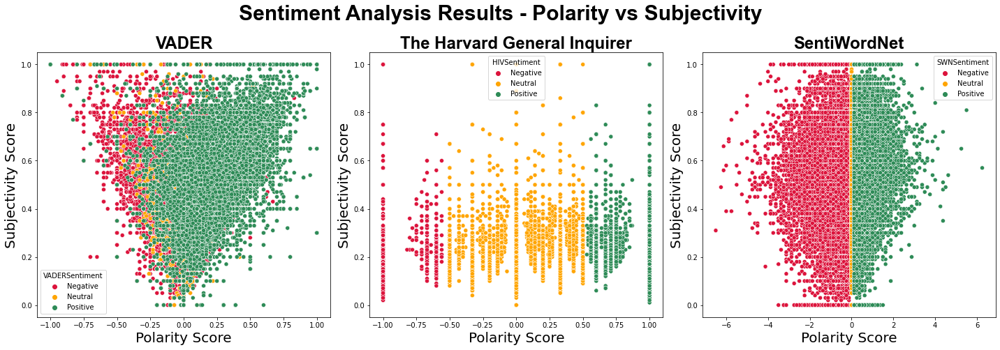

In [42]:
# Declare dataset
vader_df = app_df.sort_values('VADERSentiment')
hiv_df = app_df.sort_values('HIVSentiment')
swn_df = app_df.sort_values('SWNSentiment')

# Declare visualisation input
colors = ['crimson','orange','seagreen']
sns.set_palette(sns.color_palette(colors))
subplot_title_font_size = 24
label_font_size = 20

# Create plots
fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(20, 7))
fig.suptitle('Sentiment Analysis Results - Polarity vs Subjectivity', x=0.5, y=0.99, fontsize=30, fontfamily='arial', fontweight='bold')

ax1.set_title('VADER', fontsize=subplot_title_font_size, fontfamily='arial', fontweight='bold')
sns.scatterplot(x=vader_df['VADERPolarityScore'],
                y=vader_df['VADERSubjectivityScore'],
                hue=vader_df['VADERSentiment'],
                edgecolor='white',
                ax=ax1)

ax2.set_title('The Harvard General Inquirer', fontsize=subplot_title_font_size, fontfamily='arial', fontweight='bold')
sns.scatterplot(x=hiv_df['HIVPolarityScore'],
                y=hiv_df['HIVSubjectivityScore'],
                hue=hiv_df['HIVSentiment'],
                edgecolor='white',
                ax=ax2)

ax3.set_title('SentiWordNet', fontsize=subplot_title_font_size, fontfamily='arial', fontweight='bold')
sns.scatterplot(x=swn_df['SWNPolarityScore'],
                y=swn_df['SWNSubjectivityScore'],
                hue=swn_df['SWNSentiment'],
                edgecolor='white',
                ax=ax3)

# Customise x-label and y-label
for ax in [ax1, ax2, ax3]:
    ax.set_xlabel('Polarity Score', fontsize=label_font_size)
    ax.set_ylabel('Subjectivity Score', fontsize=label_font_size)

plt.tight_layout()
plt.show()

### 6.4.2. Sentiment Analysis Results - Sentiment vs Rating

In [43]:
def get_total_reviews_by_sentiment(df, col):
    # Count total review by sentiment
    total_review_by_sentiment = df.groupby([col, 'score'], as_index=False).agg({'reviewId':pd.Series.nunique})
    
    # Create a separate dataframe for each sentiment
    positive_df = total_review_by_sentiment[total_review_by_sentiment[col]=='Positive'].rename(columns={'reviewId':'Positive'}).drop(columns={col})
    neutral_df = total_review_by_sentiment[total_review_by_sentiment[col]=='Neutral'].rename(columns={'reviewId':'Neutral'}).drop(columns={col})
    negative_df = total_review_by_sentiment[total_review_by_sentiment[col]=='Negative'].rename(columns={'reviewId':'Negative'}).drop(columns={col})
    
    # Merge all sentiments into a single dataframe
    result_df = positive_df.merge(neutral_df, on='score').merge(negative_df, on='score').set_index('score')
    return result_df

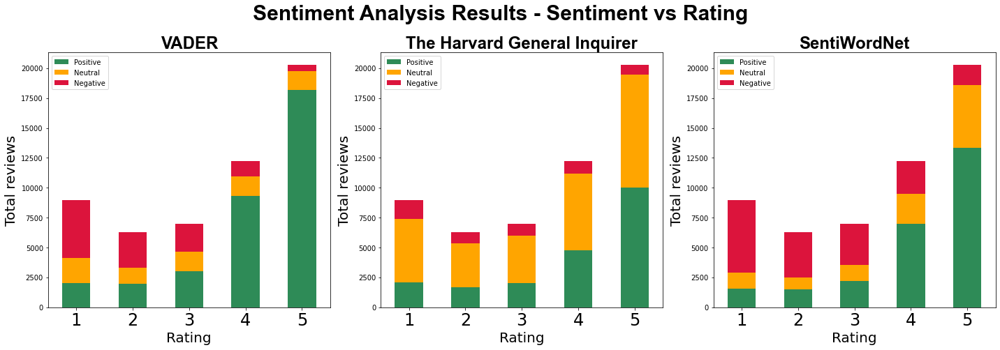

In [44]:
# Declare dataset
vader_df = get_total_reviews_by_sentiment(app_df, 'VADERSentiment')
hiv_df = get_total_reviews_by_sentiment(app_df, 'HIVSentiment')
swn_df = get_total_reviews_by_sentiment(app_df, 'SWNSentiment')

# Declare visualisation input
ax_title = ['VADER', 'The Harvard General Inquirer', 'SentiWordNet']
ax_df = [vader_df, hiv_df, swn_df]
colors = ['seagreen','orange','crimson']
sns.set_palette(sns.color_palette(colors))
subplot_title_font_size = 24
label_font_size = 20

# Create plots
fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(20, 7))
fig.suptitle('Sentiment Analysis Results - Sentiment vs Rating', x=0.5, y=0.99, fontsize=30, fontfamily='arial', fontweight='bold')

ax_list = [ax1, ax2, ax3]

for i in list(range(0, len(ax_list))):
    ax_list[i].set_title(ax_title[i], fontsize=subplot_title_font_size, fontfamily='arial', fontweight='bold')
    ax_df[i].plot(kind='bar', stacked=True, color=colors,ax=ax_list[i])
    ax_list[i].set_xlabel('Rating', fontsize=label_font_size)
    ax_list[i].set_ylabel('Total reviews', fontsize=label_font_size)
    ax_list[i].set_xticklabels(ax_list[i].get_xticklabels(), rotation=0, size=24)

plt.tight_layout()
plt.show()

# 7. Topic Modelling using TF-IDF and DBSCAN

**About DBSCAN**

DBSCAN (Density-Based Spatial Clustering of Applications with Noise) is an unsupervised learning method to separate clusters of high density from clusters of low density. Given that DBSCAN is a density based clustering algorithm, it does a great job of seeking areas in the data that have a high density of observations, versus areas of the data that are not very dense with observations. DBSCAN works as follows:
1. Divides the dataset into n dimensions.
2. For each datapoint, DBSCAN forms an n-dimensional shape around the datapoint, then counts how many data points fall within that shape.
2. DBSCAN counts this shape as a cluster. DBSCAN iteratively expands the cluster, by going through each individual point within the cluster, and counting the number of other data points nearby. Take the graphic below for an example:

**DBSCAN Advantages**
1. DBSCAN does not require one to specify the number of clusters beforehand.
2. DBSCAN performs well with arbitrary shaped clusters.
3. DBSCAN has a notion of noise, and is robust to outliers.
**DBSCAN Disadvantages**
1. DBSCAN can't cluster datasets with large differences in densities because the minPts-eps combination cannot be chosen appropriately for all clusters.
2. Choosing a meaningful eps value can be difficult if the data isn't well understood.
3. DBSCAN is not entirely deterministic. That's because the algorithm starts with a random point. Therefore border points that are reachable from more than one cluster can be part of either cluster.

**======================================== Steps to implement DBSCAN in this notebook ========================================**

**1. Obtain initial clusters using TF-IDF and DBSCAN.** This step includes:
- Tranforming text that have been cleaned in the previous step into vector using TfidfVectorizer
- Clustering the vectorised text using DBSCAN

**2. Evaluate the initial clusters.** This step includes:
- Calculating the proportion of each cluster to the entire dataset
- Creating a wordcloud for each cluster that shows the top words appearing in the cluster
- Determine the cluster name by conducting manual inspection, including grouping clusters that falls into the same category, dropping clusters that have no meaning, etc. 

**3. Assign the cluster name into the original dataframe**

**4. Visualise the top clusters,** which consists of:
- WordCloud visualisation to show top unigrams in the respective cluster
- FreqDist plots to show top bigrams in the respective cluster

**5. Visualise DBSCAN clusters in scatter plots**

**======================================================================================================================**

In [45]:
#======  Step 1: Obtain initial clusters using TF-IDF and DBSCAN  ======#
def get_topic_cluster(app_name, sentiment, max_features=100, ngram_range=(2,3), eps=0.75, min_samples=5):
    # Filter dataframe based on the app_name and sentiment
    if sentiment=='Positive':
        review_df = app_df[(app_df['app_name']==app_name) & (app_df['VADERSentiment']==sentiment) & (app_df['score']>=3)].reset_index().drop(columns={'index'})
    elif sentiment=='Negative':
        review_df = app_df[(app_df['app_name']==app_name) & (app_df['VADERSentiment']==sentiment) & (app_df['score']<=3)].reset_index().drop(columns={'index'})
    else:
        pass
    
    # Tranform text into vector using TfidfVectorizer
    review_list = review_df['clean_lemma'].to_list()
    vect = TfidfVectorizer(sublinear_tf=True,max_features=max_features, analyzer='word',ngram_range=ngram_range) 
    vect.fit(review_list)
    tf_idf = vect.transform(review_list)
    
    # Clustering using DBSCAN
    dbcluster = DBSCAN(eps=eps, min_samples=min_samples,metric='euclidean')
    topic_cluster = dbcluster.fit_predict(tf_idf)
    
    # Show results in dataframe format
    topic_cluster_df=pd.DataFrame({'clean_lemma':review_list,'topic_cluster':topic_cluster})
    review_df['topic_cluster']=topic_cluster
    
    return review_df

In [46]:
#====== Step 2: Evaluate the initial clusters ======#
def compute_cluster_size(df):
    cluster_size_df = df.groupby('topic_cluster',as_index=False).size().sort_values('size',ascending=False)
    total_reviews = len(df)
    cluster_size_df['size'] = round(cluster_size_df['size']/total_reviews*100,2)
    return cluster_size_df

def get_all_cluster_list(df):
    df = df.sort_values('size',ascending=False)
    all_clusters = df['topic_cluster'].to_list()
    return all_clusters

def get_all_cluster_size_list(df):
    all_cluster_size_list = df.sort_values('size',ascending=False)['size'].to_list()
    return all_cluster_size_list

# Visualise top unigrams of a given cluster using WordCloud
def get_single_wordcloud(col, colormap):
    review_list = col.tolist()
    review_string = " ".join(review_list)
    tokens = word_tokenize(review_string)
    
    # Remove stopwords from tokens
    stopwords_list = set(stopwords.words('english'))
    filtered_token = [token for token in tokens if not token in stopwords_list]
    
    simple_frequencies_dict = Counter(filtered_token)
    wordcloud = WordCloud(width=800,
                          height=400,
                          max_font_size=160,
                          background_color='white',
                          colormap=colormap,
                          random_state=7).generate_from_frequencies(simple_frequencies_dict)
    return wordcloud

def get_wordclouds(title, df, all_cluster_list, all_cluster_size_list, subplot_font_size, colormap):
    n_topic = len(all_cluster_list)
    index = 0
    subplot_col = 3 # Keep the number of columns at 3 regardless of the number of topics
    subplot_row = int(n_topic*2/subplot_col) # Set the number of rows to n_topic*2/subplot_col so the charts would fit regardless of the number of topics

    fig, ax = plt.subplots(figsize = (15, int(n_topic/3*5)))
    for i in list(range(0, n_topic)):
        wordcloud = get_single_wordcloud(df[df['topic_cluster']==all_cluster_list[i]]['clean_lemma'], colormap)
        plt.subplot(subplot_row, subplot_col, index+1)
        plt.title(f'Cluster {all_cluster_list[i]} ({all_cluster_size_list[i]}%) top unigrams',size=subplot_font_size)
        plt.axis('off')
        plt.tight_layout()
        plt.imshow(wordcloud)
        index += 1

In [47]:
#=====  Step 3: Assign the cluster name into the original dataframe  =====#
def get_cluster_name(df, cluster_name_dict):
    # Declare clusters that we managed to obtain
    identified_cluster_name = []
    for key, value in cluster_name_dict.items():
        identified_cluster_name += value
    
    # Assign cluster name to each review
    cluster_name_list = []
    for i in list(range(0,len(df))):
        if df['topic_cluster'][i] in identified_cluster_name:
            for key, value in cluster_name_dict.items():
                if df['topic_cluster'][i] in value:
                    cluster_name_list.append(key)
                else:
                    pass
        elif df['topic_cluster'][i] not in identified_cluster_name:
            cluster_name_list.append('Unidentified')
        else:
            pass
        
    return cluster_name_list

In [48]:
#=====  Step 4: Visualise the top clusters  =====#

# Get top clusters
def get_cluster_size_df(df, top_n_cluster=10):
    cluster_size = df.groupby(['cluster_name'],as_index=False).size()
    total_reviews = len(df)
    cluster_size['total_review_pct'] = round(cluster_size['size']/total_reviews*100,2)
    cluster_size = cluster_size.sort_values('total_review_pct',ascending=False).head(top_n_cluster)
    return cluster_size

def get_top_cluster_list(df, top_n_cluster=3):
    top_cluster_list = df[df['cluster_name']!='Unidentified'].sort_values('size',ascending=False)['cluster_name'].to_list()[:top_n_cluster]
    return top_cluster_list

def get_top_cluster_size_list(df, top_n_cluster=3):
    top_cluster_size_list = df[df['cluster_name']!='Unidentified'].sort_values('size',ascending=False)['total_review_pct'].to_list()[:top_n_cluster]
    return top_cluster_size_list

# Visualise top bigrams of a given cluster using FreqDist plots
def get_single_fdist_plot(col, top_n_words=10, palette='plasma'):
    # String tokenisation
    review_list = col.tolist()
    review_string = " ".join(review_list)
    tokens = word_tokenize(review_string)
    
    # Remove stopwords from tokens
    stopwords_list = set(stopwords.words('english'))
    filtered_token = [token for token in tokens if not token in stopwords_list]
    bigram_token = list(ngrams(filtered_token, 2))

    # Retrieve the most common bigrams
    fdist = FreqDist(bigram_token).most_common(top_n_words)
    
    # Transform to dataframe to ease visualisation process
    fdist_df = pd.DataFrame(fdist).rename(columns={0:'bigram_token',1:'count'})
 
    # Create a bar chart
    bar_plot = sns.barplot(y=fdist_df['bigram_token'], x=fdist_df['count'], orient='h', palette=palette)
    bar_plot.set(xticks=[])
    plt.xlabel(None)
    plt.ylabel(None)
    plt.yticks(fontsize=20)
    return bar_plot

def get_fdist_plots(title, df, top_cluster_list, top_cluster_size_list, top_n_words, colormap):
    n_topic = len(top_cluster_list)
    subplot_col = 3 # Keep the number of columns at 3 regardless of the number of topics
    subplot_row = int(n_topic*2/subplot_col) # Set the number of rows to n_topic*2/subplot_col so the charts would fit regardless of the number of topics
    index = 0

    fig, ax = plt.subplots(figsize = (40, int(5*subplot_row)))
    fig.suptitle(f'{title} reviews - Top bigrams of each cluster', fontsize=48, y=1, fontweight='bold')
    
    for i in list(range(0, n_topic)):
        plt.subplot(subplot_row, subplot_col, index+1)
        fdist_plot = get_single_fdist_plot(df[df['cluster_name']==top_cluster_list[i]]['clean_lemma'], top_n_words=top_n_words, palette=colormap)
        sns.despine(left=True, bottom=True)
        plt.title(f'Cluster {i+1}: {top_cluster_list[i]} ({top_cluster_size_list[i]}%)',size=30)
        plt.tight_layout()
        index+=1

In [49]:
#=====  Step 5: Visualise the DBSCAN cluster in scatter plot  =====#
def get_tfidf(app_name, sentiment, max_features=100, ngram_range=(2,3)):
    # Filter dataframe based on the app_name and sentiment
    if sentiment=='Positive':
        review_df = app_df[(app_df['app_name']==app_name) & (app_df['VADERSentiment']==sentiment) & (app_df['score']>=3)].reset_index().drop(columns={'index'})
    elif sentiment=='Negative':
        review_df = app_df[(app_df['app_name']==app_name) & (app_df['VADERSentiment']==sentiment) & (app_df['score']<=3)].reset_index().drop(columns={'index'})
    else:
        pass
    
    # Tranform text into vector using TfidfVectorizer
    review_list = review_df['clean_lemma'].to_list()
    vect = TfidfVectorizer(sublinear_tf=True,max_features=max_features, analyzer='word',ngram_range=ngram_range) 
    vect.fit(review_list)
    tf_idf = vect.transform(review_list)
    
    return tf_idf

def get_cluster_viz(df, app_name, sentiment, cluster_name_dict, colormap, max_features=50, ngram_range=(2,5), eps=0.1, min_samples=10):
    # Transform text into vectors
    tf_idf = get_tfidf(app_name, sentiment, max_features=max_features, ngram_range=ngram_range)
    tf_idf_array = tf_idf.toarray()
    
    # Clustering using DBSCAN
    dbcluster = DBSCAN(eps=eps, min_samples=min_samples, metric='euclidean')
    topic_cluster = dbcluster.fit_predict(tf_idf_array)
    
    # Change topic cluster to discrete values for better visualisation
    discrete_topic_cluster = []
    for i in range(len(topic_cluster)):
        string = "Cluster " + str(topic_cluster[i])
        discrete_topic_cluster.append(string)
    
    # Apply TSNE (Dimensionality reduction)
    # TSNE creates 2-D visual representation of multi-dimensional data while preserving local similarities
    # and spacial relationships between data points in their original, higher dimensionality
    tsne = TSNE(n_components=2).fit_transform(tf_idf_array)
    
    # Show results in dataframe format
    tsne_df=pd.DataFrame()
    tsne_df['tsne1']=tsne[:,0]
    tsne_df['tsne2']=tsne[:,1]
    tsne_df['cluster_name'] =  get_cluster_name(df, cluster_name_dict)
    
    # Declare color chart for the visualisation
    cluster_count = len(set(tsne_df['cluster_name']))
    cmap = cm.get_cmap(colormap, cluster_count)
    chart_color=[]
    for i in range(cmap.N):
        rgba = cmap(i)
        chart_color.append(matplotlib.colors.rgb2hex(rgba))
       
    # Create scatter plot
    cluster_viz = sns.scatterplot(data=tsne_df, x='tsne1', y='tsne2', hue='cluster_name',palette=chart_color)
    plt.title(f'{app_name} {sentiment.lower()} reviews by cluster')
    cluster_viz.set(xticks=[],yticks=[])
    sns.despine(left=True, bottom=True)
    cluster_viz.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
    plt.xlabel(None)
    plt.ylabel(None)
    plt.show()

## 7.1. Amazon topic modelling

### 7.1.1. Amazon topic modelling - Negative sentiment

36 clusters were successfully created


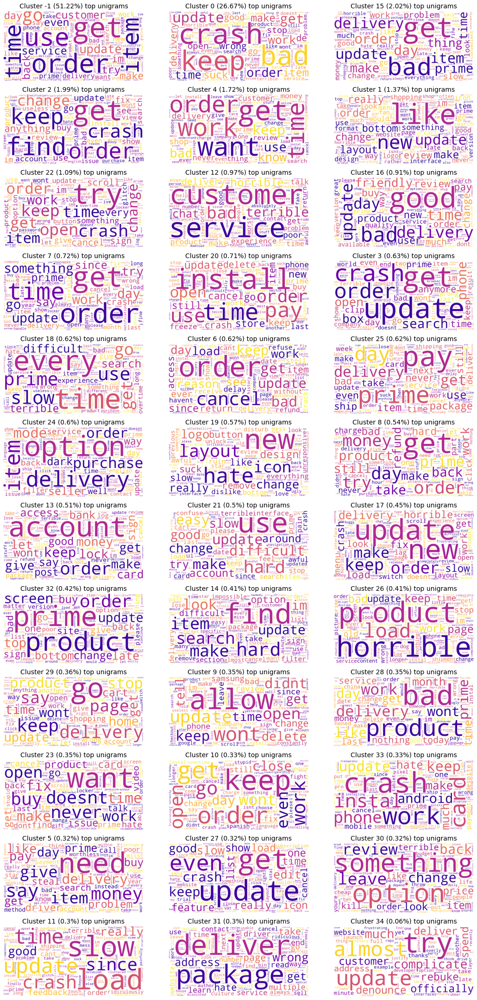

In [50]:
# Get topic clusters
amazon_neg_df = get_topic_cluster('Amazon', 'Negative', max_features=50, ngram_range=(2,3), eps=0.5, min_samples=20)

# Count the unique number of clusters
num_cluster = len(set(amazon_neg_df['topic_cluster']))
print('\033[1m' + f'{num_cluster} clusters were successfully created')

# Get cluster size
amazon_neg_cluster_size_df = compute_cluster_size(amazon_neg_df)

# Show all clusters
amazon_neg_all_clusters = get_all_cluster_list(amazon_neg_cluster_size_df)
amazon_neg_all_cluster_size = get_all_cluster_size_list(amazon_neg_cluster_size_df)

get_wordclouds('Amazon negative', amazon_neg_df, amazon_neg_all_clusters, amazon_neg_all_cluster_size, 14, 'plasma')

In [51]:
# Create a dict of cluster name and cluster number
amazon_neg_cluster_name = {'App crash/slow': [0, 2, 22, 7, 3, 26, 29, 9, 23, 10, 33, 11],
                           'Delivery issues': [15, 24, 28, 5, 31],
                           'Order issues': [4, 6, 30],
                           'New design/updates complaints': [1, 19, 17],
                           'Poor customer service': [12],
                           'Poor usability': [16, 21],
                           'Installation issues': [20],
                           'Amazon Prime issues': [18, 25, 32],
                           'Refund issues': [8]
                          }             

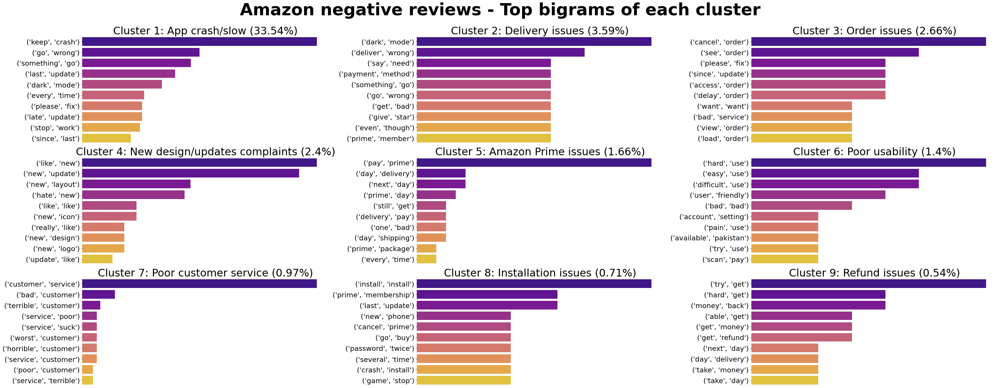

In [52]:
# Append cluster name into the original dataframe
amazon_neg_df['cluster_name'] = get_cluster_name(amazon_neg_df, amazon_neg_cluster_name)
amazon_neg_cluster_size_df = get_cluster_size_df(amazon_neg_df, top_n_cluster=50)

# Get top topic clusters
amazon_neg_top_topic_cluster = get_top_cluster_list(amazon_neg_cluster_size_df, top_n_cluster=20)
amazon_neg_top_topic_cluster_size = get_top_cluster_size_list(amazon_neg_cluster_size_df, top_n_cluster=20)

# Top topics
get_fdist_plots('Amazon negative', amazon_neg_df, amazon_neg_top_topic_cluster, amazon_neg_top_topic_cluster_size, 10, 'plasma')

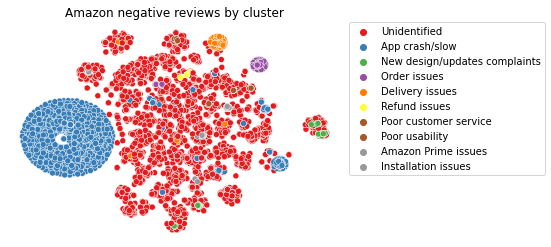

In [53]:
get_cluster_viz(amazon_neg_df, 'Amazon', 'Negative', amazon_neg_cluster_name, 'Set1', max_features=50, ngram_range=(2,3), eps=0.5, min_samples=20)

### 7.1.2. Amazon topic modelling - Positive sentiment

30 clusters were successfully created


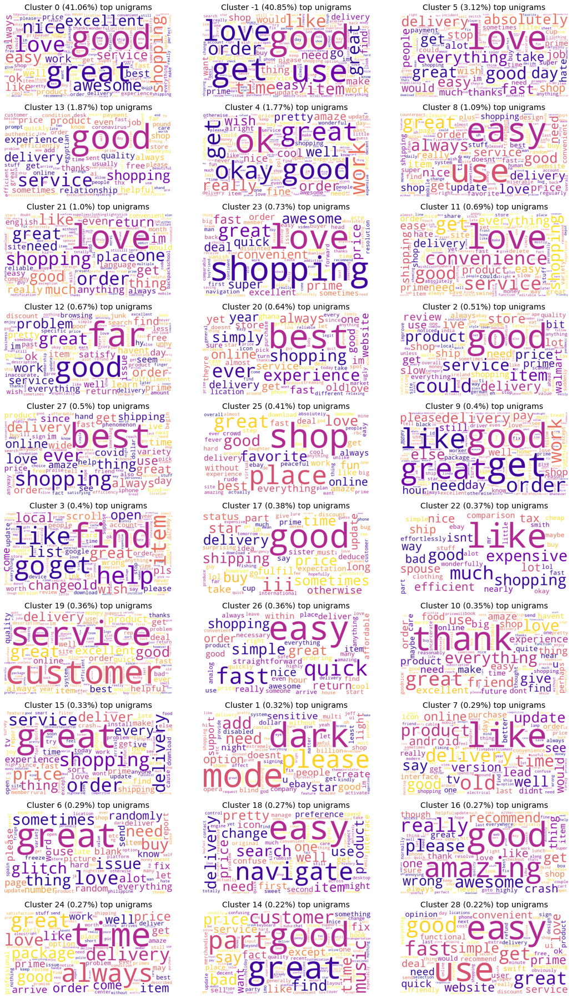

In [54]:
# Get topic clusters
amazon_pos_df = get_topic_cluster('Amazon', 'Positive', max_features=100, ngram_range=(2,5), eps=0.5, min_samples=20)

# Count the unique number of clusters
num_cluster = len(set(amazon_pos_df['topic_cluster']))
print('\033[1m' + f'{num_cluster} clusters were successfully created')

# Get cluster size
amazon_pos_cluster_size_df = compute_cluster_size(amazon_pos_df)

# Show all clusters
amazon_pos_all_clusters = get_all_cluster_list(amazon_pos_cluster_size_df)
amazon_pos_all_cluster_size = get_all_cluster_size_list(amazon_pos_cluster_size_df)

get_wordclouds('Amazon positive', amazon_pos_df, amazon_pos_all_clusters, amazon_pos_all_cluster_size, 14, 'plasma')

In [55]:
# Create a dict of cluster name and cluster number
amazon_pos_cluster_name = {'Good, love, satisfied': [0, 3, 13, 4, 12, 9, 17, 22, 10, 6, 16, 14],
                           'Easy to use': [8, 26, 18, 28],
                           'Convenient shopping': [21, 23, 11],
                           'Best shopping experience': [20, 27],
                           'Great customer service': [2, 19, 15],
                           'Favorite place to shop': [25],
                           'Dark mode request': [1],
                           'Prefer old version':[7],
                           'Punctual delivery': [24]
                          }

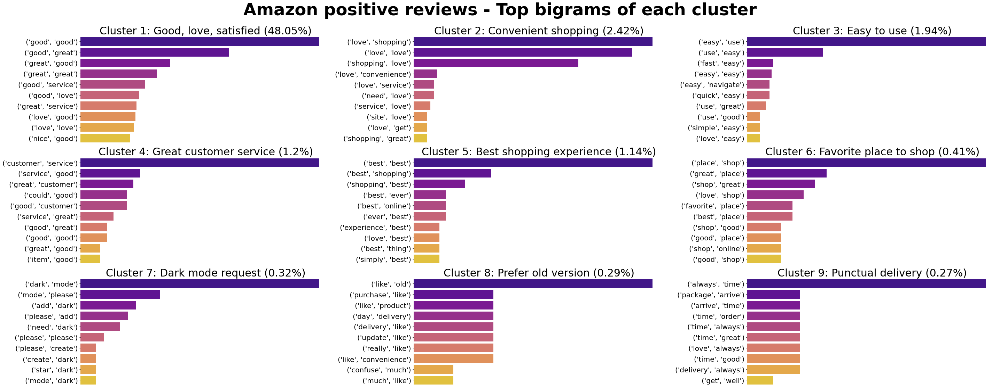

In [56]:
# Append cluster name into the original dataframe
amazon_pos_df['cluster_name'] = get_cluster_name(amazon_pos_df, amazon_pos_cluster_name)
amazon_pos_cluster_size_df = get_cluster_size_df(amazon_pos_df, top_n_cluster=50)

# Get top topic clusters
amazon_pos_top_topic_cluster = get_top_cluster_list(amazon_pos_cluster_size_df, top_n_cluster=20)
amazon_pos_top_topic_cluster_size = get_top_cluster_size_list(amazon_pos_cluster_size_df, top_n_cluster=20)

# Top topics
get_fdist_plots('Amazon positive', amazon_pos_df, amazon_pos_top_topic_cluster, amazon_pos_top_topic_cluster_size, 10, 'plasma')

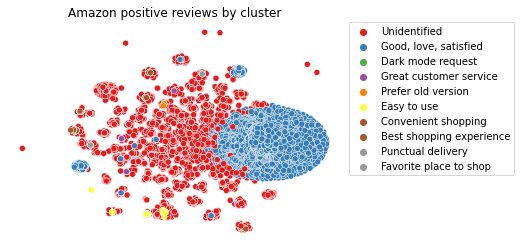

In [57]:
get_cluster_viz(amazon_pos_df, 'Amazon', 'Positive', amazon_pos_cluster_name, 'Set1', max_features=100, ngram_range=(2,5), eps=0.5, min_samples=20)

## 7.2. Tesco topic modelling

### 7.2.1. Tesco topic modelling - Negative sentiment

33 clusters were successfully created


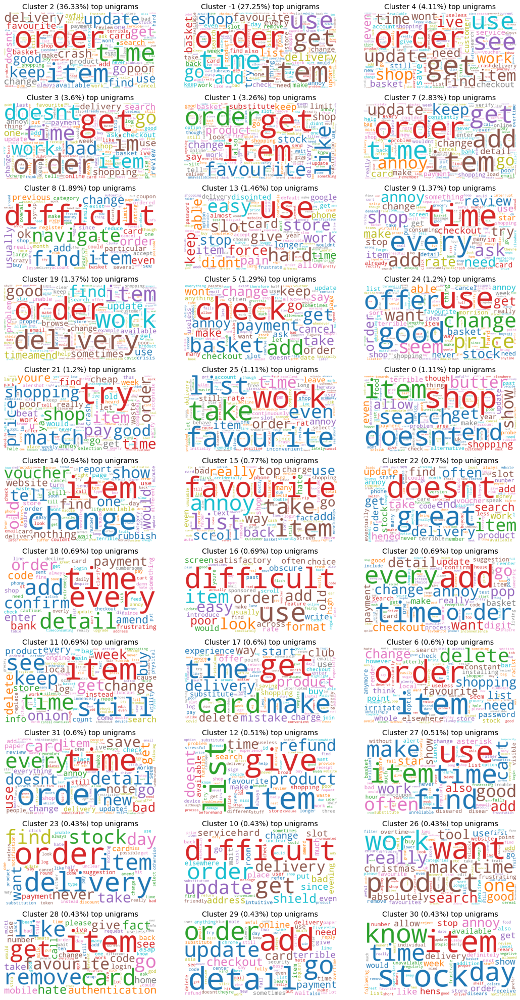

In [58]:
# Get topic clusters
tesco_neg_df = get_topic_cluster('Tesco', 'Negative', max_features=20, ngram_range=(2,3), eps=0.5, min_samples=5)

# Count the unique number of clusters
num_cluster = len(set(tesco_neg_df['topic_cluster']))
print('\033[1m' + f'{num_cluster} clusters were successfully created')

# Get cluster size
tesco_neg_cluster_size_df = compute_cluster_size(tesco_neg_df)

# Show all clusters
tesco_neg_all_clusters = get_all_cluster_list(tesco_neg_cluster_size_df)
tesco_neg_all_cluster_size = get_all_cluster_size_list(tesco_neg_cluster_size_df)

get_wordclouds('Tesco negative', tesco_neg_df, tesco_neg_all_clusters, tesco_neg_all_cluster_size, 14, 'tab10')

In [59]:
#Create a dict of cluster name and cluster number
tesco_neg_cluster_name = {'App crash':[2,1,4],
                          'Complaints - Customer service': [5],
                          'Difficulty finding items':[3, 14,11,26],
                          'Poor usability':[8,15,12],
                          'Stock issues':[23,28],
                          'Delivery issues':[10],
                          'Payment issues':[20,19,16,17,22,21,24],
                          'Account issues':[18]
                         }

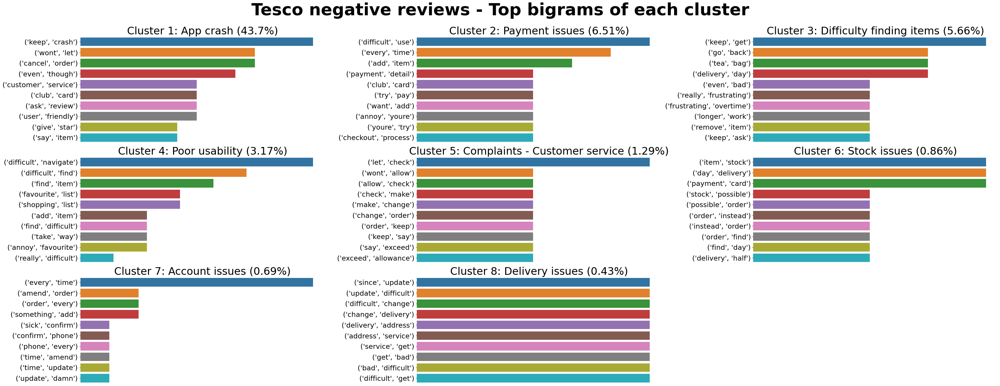

In [60]:
# Append cluster name into the original dataframe
tesco_neg_df['cluster_name'] = get_cluster_name(tesco_neg_df, tesco_neg_cluster_name)
tesco_neg_cluster_size_df = get_cluster_size_df(tesco_neg_df, top_n_cluster=50)

# Get top topic clusters
tesco_neg_top_topic_cluster = get_top_cluster_list(tesco_neg_cluster_size_df, top_n_cluster=20)
tesco_neg_top_topic_cluster_size = get_top_cluster_size_list(tesco_neg_cluster_size_df, top_n_cluster=20)

# Top topics
get_fdist_plots('Tesco negative', tesco_neg_df, tesco_neg_top_topic_cluster, tesco_neg_top_topic_cluster_size, 10, 'tab10')

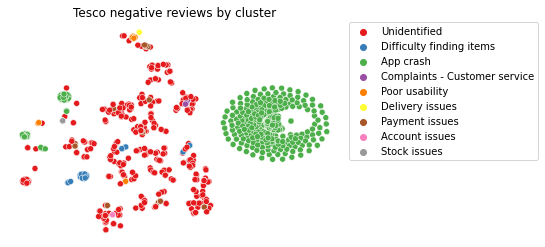

In [61]:
get_cluster_viz(tesco_neg_df, 'Tesco', 'Negative', tesco_neg_cluster_name, 'Set1', max_features=20, ngram_range=(2,3), eps=0.5, min_samples=5)

### 7.2.2. Tesco topic modelling - Positive sentiment

6 clusters were successfully created


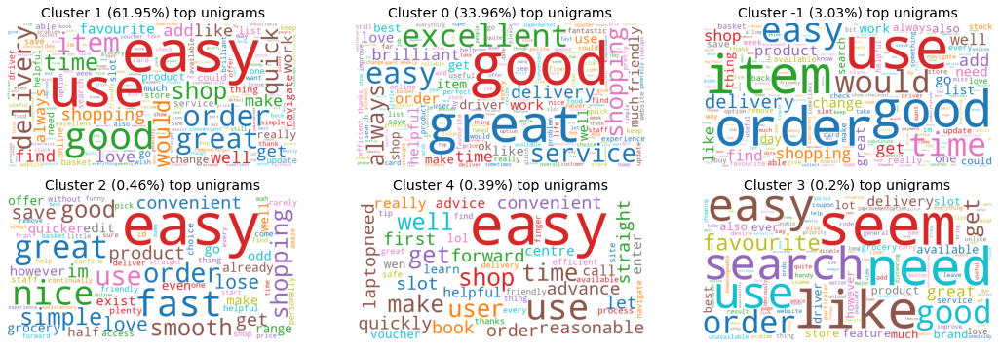

In [62]:
# Get topic clusters
tesco_pos_df = get_topic_cluster('Tesco', 'Positive', max_features=50, ngram_range=(2,3), eps=0.75, min_samples=10)

# Count the unique number of clusters
num_cluster = len(set(tesco_pos_df['topic_cluster']))
print('\033[1m' + f'{num_cluster} clusters were successfully created')

# Get cluster size
tesco_pos_cluster_size_df = compute_cluster_size(tesco_pos_df)

# Show all clusters
tesco_pos_all_clusters = get_all_cluster_list(tesco_pos_cluster_size_df)
tesco_pos_all_cluster_size = get_all_cluster_size_list(tesco_pos_cluster_size_df)

get_wordclouds('Tesco positive', tesco_pos_df, tesco_pos_all_clusters, tesco_pos_all_cluster_size, 14, 'tab10')

In [63]:
# Create a dict of cluster name and cluster number
tesco_pos_cluster_name = {'Easy to use': [1,-1,2,4],
                         'Good, great': [0],
                         'Search feature':[3]}

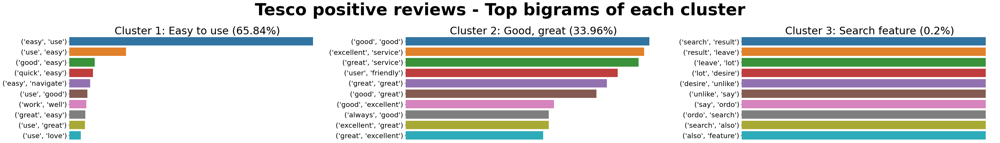

In [64]:
# Append cluster name into the original dataframe
tesco_pos_df['cluster_name'] = get_cluster_name(tesco_pos_df, tesco_pos_cluster_name)
tesco_pos_cluster_size_df = get_cluster_size_df(tesco_pos_df, top_n_cluster=50)

# Get top topic clusters
tesco_pos_top_topic_cluster = get_top_cluster_list(tesco_pos_cluster_size_df, top_n_cluster=20)
tesco_pos_top_topic_cluster_size = get_top_cluster_size_list(tesco_pos_cluster_size_df, top_n_cluster=20)

# Top topics
get_fdist_plots('Tesco positive', tesco_pos_df, tesco_pos_top_topic_cluster, tesco_pos_top_topic_cluster_size, 10, 'tab10')

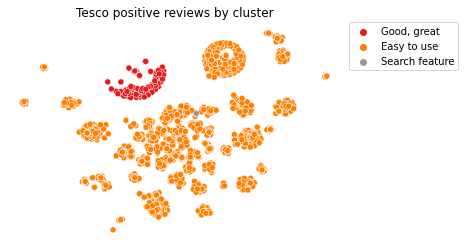

In [65]:
get_cluster_viz(tesco_pos_df, 'Tesco', 'Positive', tesco_pos_cluster_name, 'Set1', max_features=50, ngram_range=(2,3), eps=0.75, min_samples=10)

## 7.3. M&S topic modelling

### 7.3.1. M&S topic modelling - Negative sentiment

26 clusters were successfully created


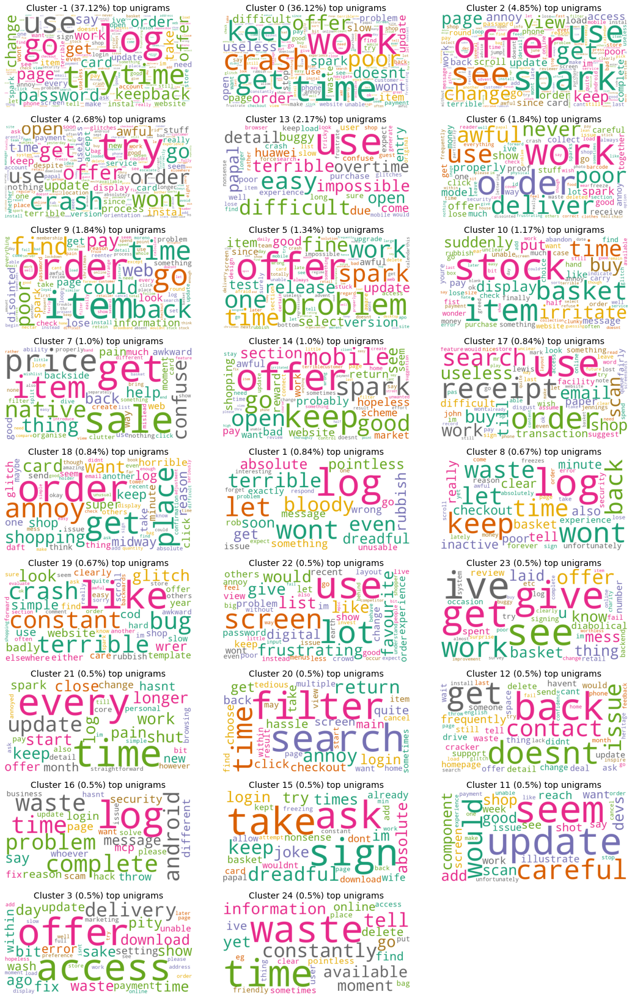

In [66]:
# Get topic clusters
mns_neg_df = get_topic_cluster('M&S', 'Negative', max_features=25, ngram_range=(2,3), eps=0.1, min_samples=3)

# Count the unique number of clusters
num_cluster = len(set(mns_neg_df['topic_cluster']))
print('\033[1m' + f'{num_cluster} clusters were successfully created')

# Get cluster size
mns_neg_cluster_size_df = compute_cluster_size(mns_neg_df)

# Show all clusters
mns_neg_all_clusters = get_all_cluster_list(mns_neg_cluster_size_df)
mns_neg_all_cluster_size = get_all_cluster_size_list(mns_neg_cluster_size_df)

get_wordclouds('M&S negative', mns_neg_df, mns_neg_all_clusters, mns_neg_all_cluster_size, 14, 'Dark2')

In [67]:
# Create a dict of cluster name and cluster number
mns_neg_cluster_name = {'Complaints - M&S Sparks offers':[0,2],
                        'App crash':[4,9,17,14,13],
                        'Login and password issues':[-1,1,12,11,7,15,16,10,18,8,19],
                       }

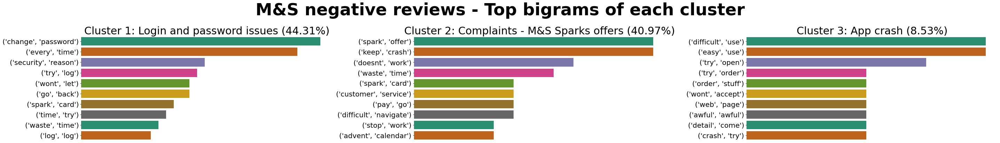

In [68]:
# Append cluster name into the original dataframe
mns_neg_df['cluster_name'] = get_cluster_name(mns_neg_df, mns_neg_cluster_name)
mns_neg_cluster_size_df = get_cluster_size_df(mns_neg_df, top_n_cluster=50)

# Get top topic clusters
mns_neg_top_topic_cluster = get_top_cluster_list(mns_neg_cluster_size_df, top_n_cluster=20)
mns_neg_top_topic_cluster_size = get_top_cluster_size_list(mns_neg_cluster_size_df, top_n_cluster=20)

# Top topics
get_fdist_plots('M&S negative', mns_neg_df, mns_neg_top_topic_cluster, mns_neg_top_topic_cluster_size, 10, 'Dark2')

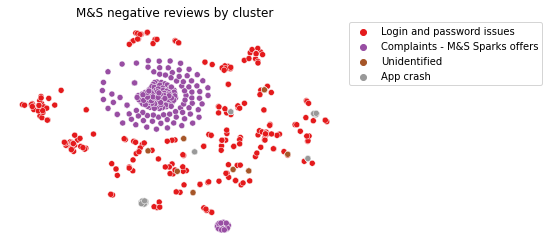

In [69]:
get_cluster_viz(mns_neg_df, 'M&S', 'Negative', mns_neg_cluster_name, 'Set1', max_features=25, ngram_range=(2,3), eps=0.1, min_samples=3)

### 7.3.2. M&S topic modelling - Positive sentiment

35 clusters were successfully created


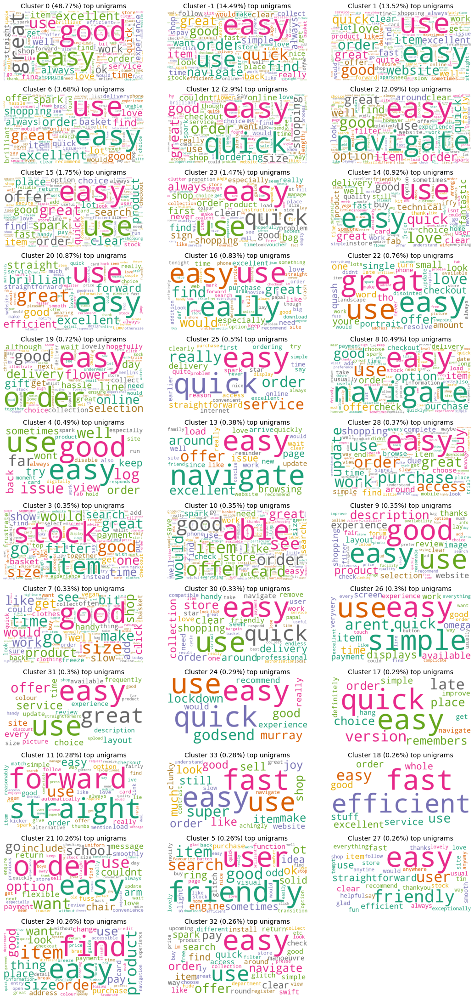

In [70]:
# Get topic clusters
mns_pos_df = get_topic_cluster('M&S', 'Positive', max_features=100, ngram_range=(3,5), eps=0.5, min_samples=20)

# Count the unique number of clusters
num_cluster = len(set(mns_pos_df['topic_cluster']))
print('\033[1m' + f'{num_cluster} clusters were successfully created')

# Get cluster size
mns_pos_cluster_size_df = compute_cluster_size(mns_pos_df)

# Show all clusters
mns_pos_all_clusters = get_all_cluster_list(mns_pos_cluster_size_df)
mns_pos_all_cluster_size = get_all_cluster_size_list(mns_pos_cluster_size_df)

get_wordclouds('M&S positive', mns_pos_df, mns_pos_all_clusters, mns_pos_all_cluster_size, 14, 'Dark2')

In [71]:
# Create a dict of cluster name and cluster number
mns_pos_cluster_name = {'Good, straightforward': [0],
                        'Easy to use and quick': [-1, 1, 6, 15, 23, 14, 20, 16, 22,4,9,26,31,24,33,5,27,32,12,25,30,17,18,7,11],
                        'Easy to navigate':[2,8,13],
                        'Easy to order':[19,28,21,29],
                        'Feedback - Stock':[3]
                       }

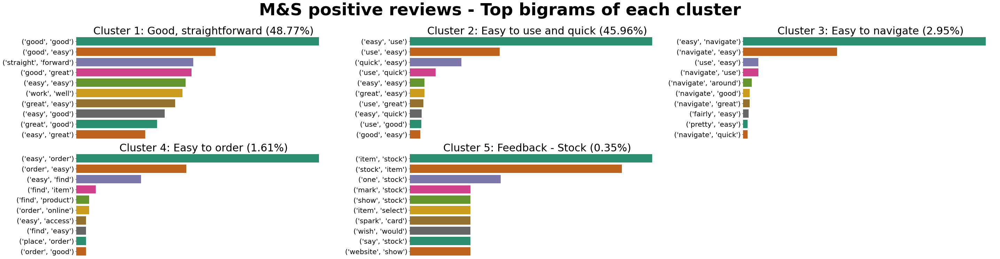

In [72]:
# Append cluster name into the original dataframe
mns_pos_df['cluster_name'] = get_cluster_name(mns_pos_df, mns_pos_cluster_name)
mns_pos_cluster_size_df = get_cluster_size_df(mns_pos_df, top_n_cluster=50)

# Get top topic clusters
mns_pos_top_topic_cluster = get_top_cluster_list(mns_pos_cluster_size_df, top_n_cluster=20)
mns_pos_top_topic_cluster_size = get_top_cluster_size_list(mns_pos_cluster_size_df, top_n_cluster=20)

# Top topics
get_fdist_plots('M&S positive', mns_pos_df, mns_pos_top_topic_cluster, mns_pos_top_topic_cluster_size, 10, 'Dark2')

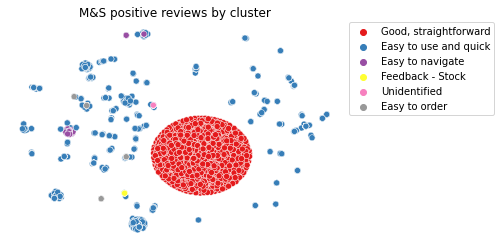

In [73]:
get_cluster_viz(mns_pos_df, 'M&S', 'Positive', mns_pos_cluster_name, 'Set1', max_features=100, ngram_range=(3,5), eps=0.5, min_samples=20)

## 7.4. Boots topic modelling

### 7.4.1. Boots topic modelling - Negative sentiment

12 clusters were successfully created


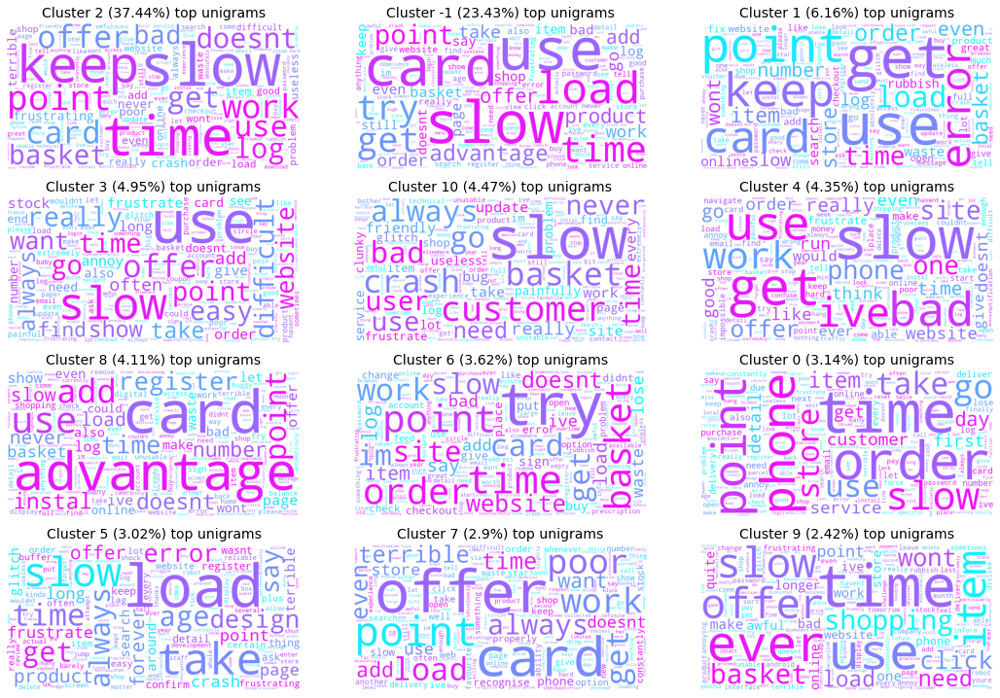

In [74]:
# Get topic clusters
boots_neg_df = get_topic_cluster('Boots', 'Negative', max_features=10, ngram_range=(2,3), eps=0.5, min_samples=10)

# Count the unique number of clusters
num_cluster = len(set(boots_neg_df['topic_cluster']))
print('\033[1m' + f'{num_cluster} clusters were successfully created')

# Get cluster size
boots_neg_cluster_size_df = compute_cluster_size(boots_neg_df)

# Show all clusters
boots_neg_all_clusters = get_all_cluster_list(boots_neg_cluster_size_df)
boots_neg_all_cluster_size = get_all_cluster_size_list(boots_neg_cluster_size_df)

get_wordclouds('Boots negative', boots_neg_df, boots_neg_all_clusters, boots_neg_all_cluster_size, 14, 'cool_r')

In [75]:
# Create a dict of cluster name and cluster number
boots_neg_cluster_name = {'App crash/slow':[2,3,10,5],
                          'Complaints - Advantage card':[1,7,8],
                          'Complaints - Ordering':[6,0]
                       }

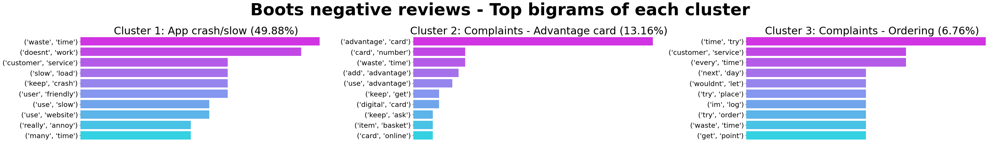

In [76]:
# Append cluster name into the original dataframe
boots_neg_df['cluster_name'] = get_cluster_name(boots_neg_df, boots_neg_cluster_name)
boots_neg_cluster_size_df = get_cluster_size_df(boots_neg_df, top_n_cluster=50)

# Get top topic clusters
boots_neg_top_topic_cluster = get_top_cluster_list(boots_neg_cluster_size_df, top_n_cluster=20)
boots_neg_top_topic_cluster_size = get_top_cluster_size_list(boots_neg_cluster_size_df, top_n_cluster=20)

# Top topics
get_fdist_plots('Boots negative', boots_neg_df, boots_neg_top_topic_cluster, boots_neg_top_topic_cluster_size, 10, 'cool_r')

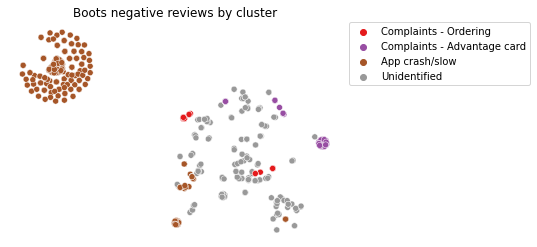

In [77]:
get_cluster_viz(boots_neg_df, 'Boots', 'Negative', boots_neg_cluster_name, 'Set1', max_features=10, ngram_range=(2,3), eps=0.5, min_samples=10)

### 7.4.2. Boots topic modelling - Positive sentiment

15 clusters were successfully created


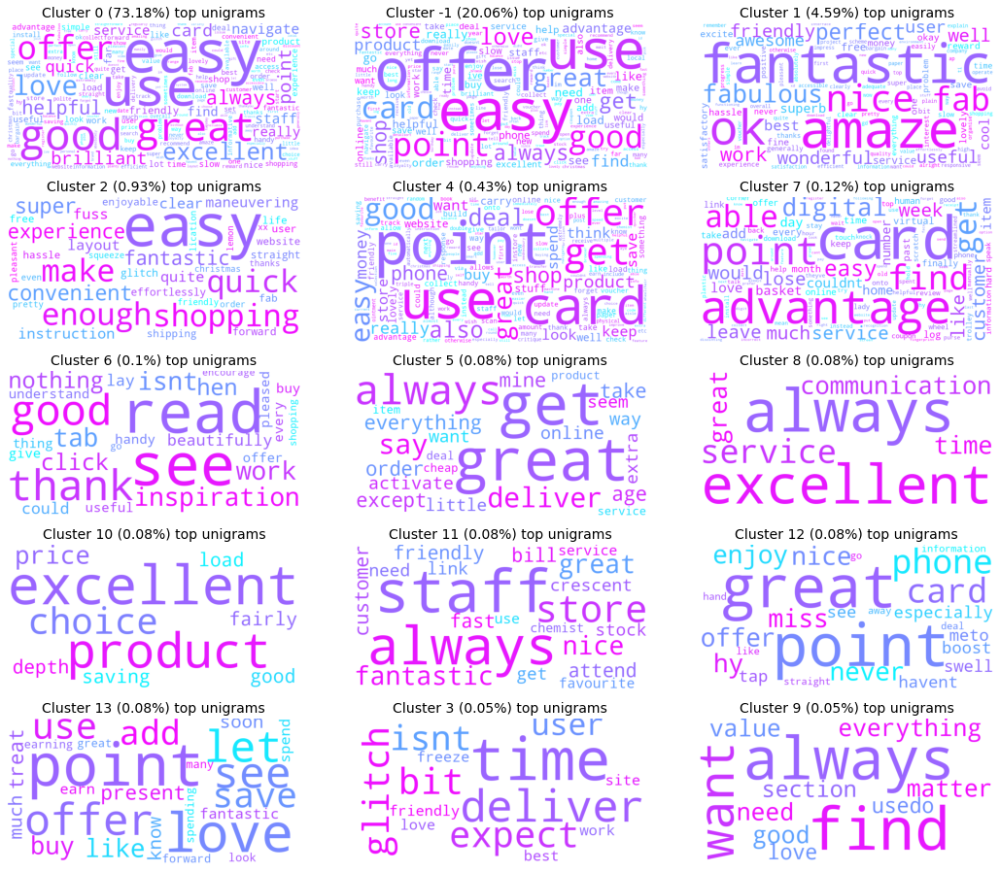

In [78]:
# Get topic clusters
boots_pos_df = get_topic_cluster('Boots', 'Positive', max_features=50, ngram_range=(1,2), eps=0.7, min_samples=5)

# Count the unique number of clusters
num_cluster = len(set(boots_pos_df['topic_cluster']))
print('\033[1m' + f'{num_cluster} clusters were successfully created')

# Get cluster size
boots_pos_cluster_size_df = compute_cluster_size(boots_pos_df)

# Show all clusters
boots_pos_all_clusters = get_all_cluster_list(boots_pos_cluster_size_df)
boots_pos_all_cluster_size = get_all_cluster_size_list(boots_pos_cluster_size_df)

get_wordclouds('Boots positive', boots_pos_df, boots_pos_all_clusters, boots_pos_all_cluster_size, 14, 'cool_r')

In [79]:
# Create a dict of cluster name and cluster number
boots_pos_cluster_name = {'Easy to use':[0,2],
                          'Great, fantastic':[1,5,8,20],
                         'Advantage card':[4,7,12,13],
                         }

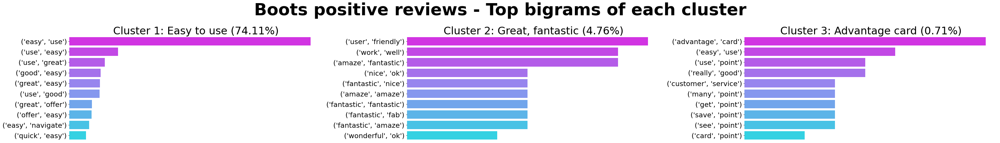

In [80]:
# Append cluster name into the original dataframe
boots_pos_df['cluster_name'] = get_cluster_name(boots_pos_df, boots_pos_cluster_name)
boots_pos_cluster_size_df = get_cluster_size_df(boots_pos_df, top_n_cluster=50)

# Get top topic clusters
boots_pos_top_topic_cluster = get_top_cluster_list(boots_pos_cluster_size_df, top_n_cluster=20)
boots_pos_top_topic_cluster_size = get_top_cluster_size_list(boots_pos_cluster_size_df, top_n_cluster=20)

# Top topics
get_fdist_plots('Boots positive', boots_pos_df, boots_pos_top_topic_cluster, boots_pos_top_topic_cluster_size, 10, 'cool_r')

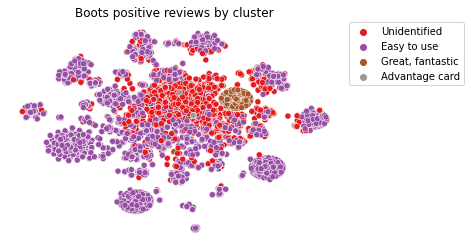

In [81]:
get_cluster_viz(boots_pos_df, 'Boots', 'Positive', boots_pos_cluster_name, 'Set1', max_features=50, ngram_range=(1,2), eps=0.7, min_samples=5)

## 7.5. Argos topic modelling

### 7.5.1. Argos topic modelling - Negative sentiment

18 clusters were successfully created


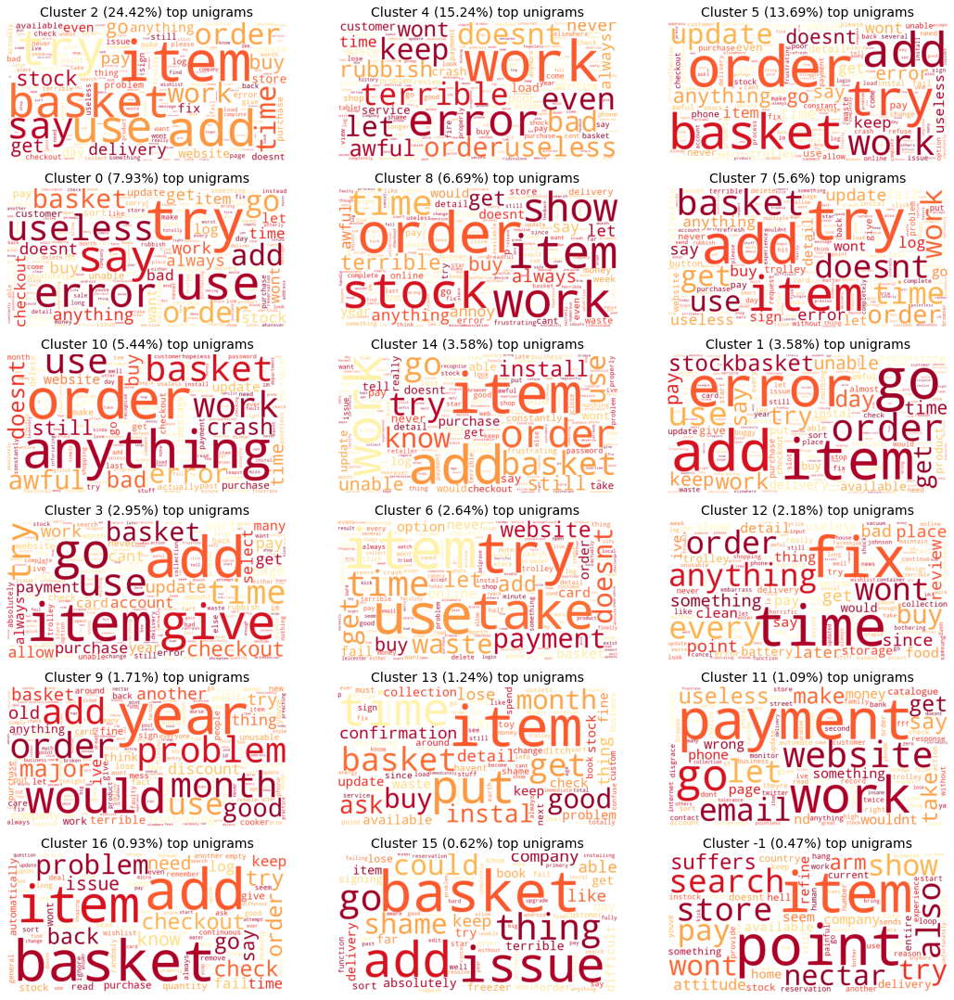

In [82]:
# Get topic clusters
argos_neg_df = get_topic_cluster('Argos', 'Negative', max_features=3, ngram_range=(1,2), eps=0.1, min_samples=5)

# Count the unique number of clusters
num_cluster = len(set(argos_neg_df['topic_cluster']))
print('\033[1m' + f'{num_cluster} clusters were successfully created')

# Get cluster size
argos_neg_cluster_size_df = compute_cluster_size(argos_neg_df)

# Show all clusters
argos_neg_all_clusters = get_all_cluster_list(argos_neg_cluster_size_df)
argos_neg_all_cluster_size = get_all_cluster_size_list(argos_neg_cluster_size_df)

get_wordclouds('Argos negative', argos_neg_df, argos_neg_all_clusters, argos_neg_all_cluster_size, 14, 'YlOrRd_r')

In [83]:
# Create a dict of cluster name and cluster number
argos_neg_cluster_name = {'Unable to add items to the basket': [2,5,7,10,14,1,3,6,9,13,16,15],
                          'App crash':[4,0],
                          'Stock issues':[8],
                          'Payment issues':[11]
                         }

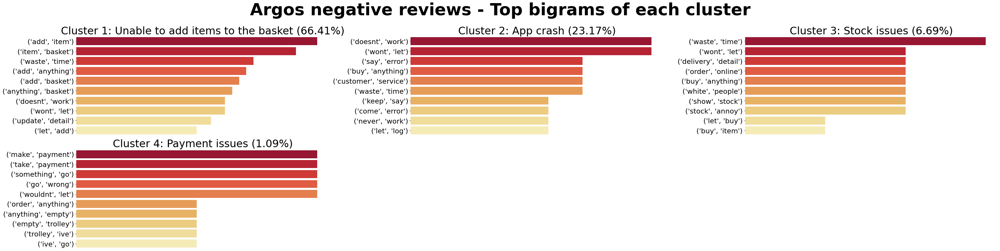

In [84]:
# Append cluster name into the original dataframe
argos_neg_df['cluster_name'] = get_cluster_name(argos_neg_df, argos_neg_cluster_name)
argos_neg_cluster_size_df = get_cluster_size_df(argos_neg_df, top_n_cluster=50)

# Get top topic clusters
argos_neg_top_topic_cluster = get_top_cluster_list(argos_neg_cluster_size_df, top_n_cluster=20)
argos_neg_top_topic_cluster_size = get_top_cluster_size_list(argos_neg_cluster_size_df, top_n_cluster=20)

# Top topics
get_fdist_plots('Argos negative', argos_neg_df, argos_neg_top_topic_cluster, argos_neg_top_topic_cluster_size, 10, 'YlOrRd_r')

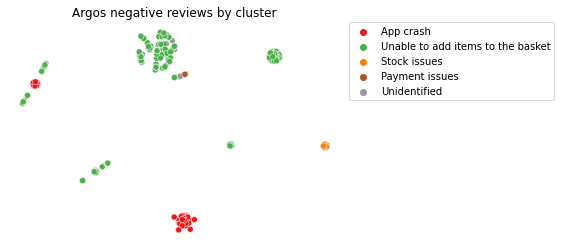

In [85]:
get_cluster_viz(argos_neg_df, 'Argos', 'Negative', argos_neg_cluster_name, 'Set1', max_features=3, ngram_range=(1,2), eps=0.1, min_samples=5)

### 7.5.2. Argos topic modelling - Positive sentiment

12 clusters were successfully created


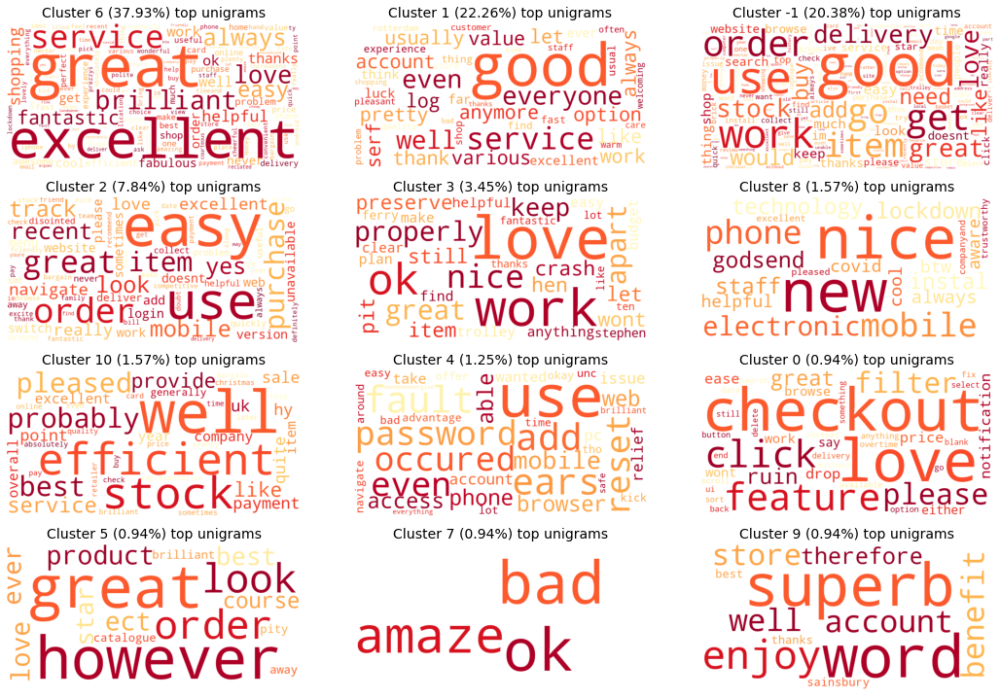

In [86]:
# Get topic clusters
argos_pos_df = get_topic_cluster('Argos', 'Positive', max_features=5, ngram_range=(1,2), eps=0.1, min_samples=3)

# Count the unique number of clusters
num_cluster = len(set(argos_pos_df['topic_cluster']))
print('\033[1m' + f'{num_cluster} clusters were successfully created')

# Get cluster size
argos_pos_cluster_size_df = compute_cluster_size(argos_pos_df)

# Show all clusters
argos_pos_all_clusters = get_all_cluster_list(argos_pos_cluster_size_df)
argos_pos_all_cluster_size = get_all_cluster_size_list(argos_pos_cluster_size_df)

get_wordclouds('Argos negative', argos_pos_df, argos_pos_all_clusters, argos_pos_all_cluster_size, 14, 'YlOrRd_r')

In [88]:
# Create a dict of cluster name and cluster number
argos_pos_cluster_name = {'Great service':[6],
                          'Good': [1],
                          'Easy to use':[2]
                         }

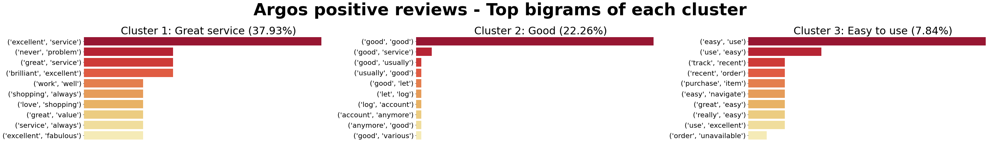

In [89]:
# Append cluster name into the original dataframe
argos_pos_df['cluster_name'] = get_cluster_name(argos_pos_df, argos_pos_cluster_name)
argos_pos_cluster_size_df = get_cluster_size_df(argos_pos_df, top_n_cluster=50)

# Get top topic clusters
argos_pos_top_topic_cluster = get_top_cluster_list(argos_pos_cluster_size_df, top_n_cluster=20)
argos_pos_top_topic_cluster_size = get_top_cluster_size_list(argos_pos_cluster_size_df, top_n_cluster=20)

# Top topics
get_fdist_plots('Argos positive', argos_pos_df, argos_pos_top_topic_cluster, argos_pos_top_topic_cluster_size, 10, 'YlOrRd_r')

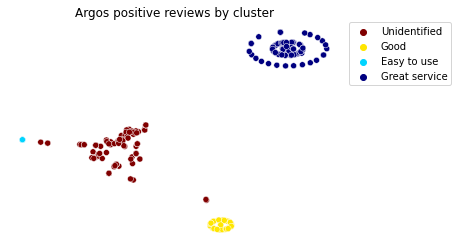

In [91]:
get_cluster_viz(argos_pos_df, 'Argos', 'Positive', argos_pos_cluster_name, 'jet_r', max_features=5, ngram_range=(1,2), eps=0.1, min_samples=3)

### 7.6. Morrisons topic modelling

#### 7.6.1. Morrisons topic modelling - Negative sentiment

39 clusters were successfully created


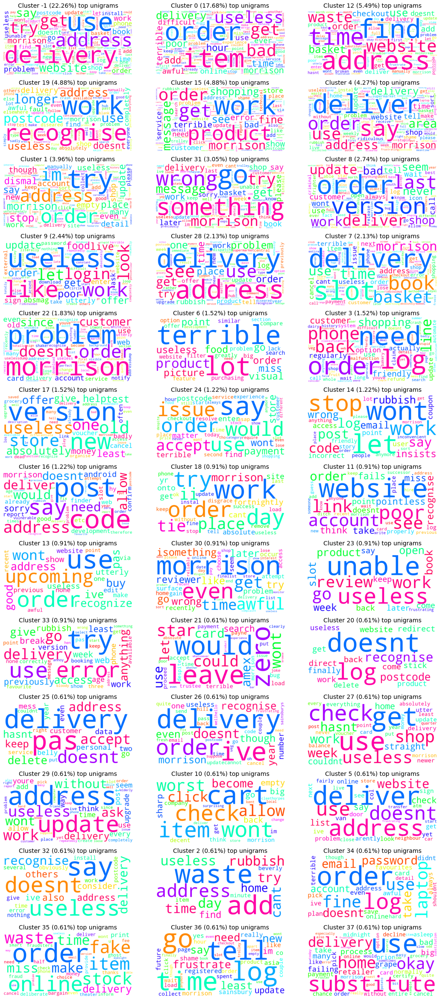

In [92]:
# Get topic clusters
mor_neg_df = get_topic_cluster('Morrisons', 'Negative', max_features=100, ngram_range=(2,5), eps=0.9, min_samples=2)

# Count the unique number of clusters
num_cluster = len(set(mor_neg_df['topic_cluster']))
print('\033[1m' + f'{num_cluster} clusters were successfully created')

# Get cluster size
mor_neg_cluster_size_df = compute_cluster_size(mor_neg_df)

# Show all clusters
mor_neg_all_clusters = get_all_cluster_list(mor_neg_cluster_size_df)
mor_neg_all_cluster_size = get_all_cluster_size_list(mor_neg_cluster_size_df)

get_wordclouds('Morrisons negative', mor_neg_df, mor_neg_all_clusters, mor_neg_all_cluster_size, 14, 'hsv_r')

In [93]:
# Create a dict of cluster name and cluster number
mor_neg_cluster_name = {'Delivery issues':[-1,12,19,4,1,28,7,22,24,16,5,29,26,25,20,37,2,27,13],
                        'Missing items':[0,35],
                        'Customer service issues':[15],
                        'App crash':[31,8,14,33],
                        'Sign in and password issues':[9,34,11],
                        'Useless':[6,17,32,23],
                       }                        

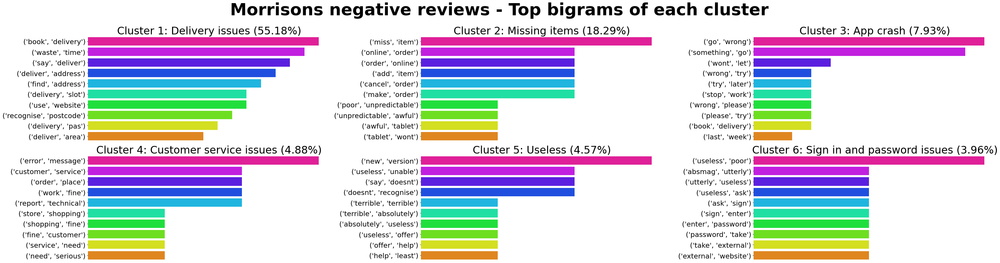

In [94]:
# Append cluster name into the original dataframe
mor_neg_df['cluster_name'] = get_cluster_name(mor_neg_df, mor_neg_cluster_name)
mor_neg_cluster_size_df = get_cluster_size_df(mor_neg_df, top_n_cluster=50)

# Get top topic clusters
mor_neg_top_topic_cluster = get_top_cluster_list(mor_neg_cluster_size_df, top_n_cluster=20)
mor_neg_top_topic_cluster_size = get_top_cluster_size_list(mor_neg_cluster_size_df, top_n_cluster=20)

# Top topics
get_fdist_plots('Morrisons negative', mor_neg_df, mor_neg_top_topic_cluster,mor_neg_top_topic_cluster_size, 10, 'hsv_r')

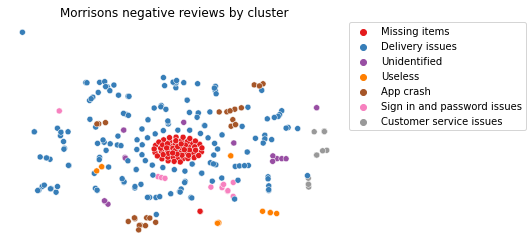

In [95]:
get_cluster_viz(mor_neg_df, 'Morrisons', 'Negative', mor_neg_cluster_name, 'Set1', max_features=100, ngram_range=(2,5), eps=0.9, min_samples=2)

#### 7.6.2. Morrisons topic modelling - Positive sentiment

29 clusters were successfully created


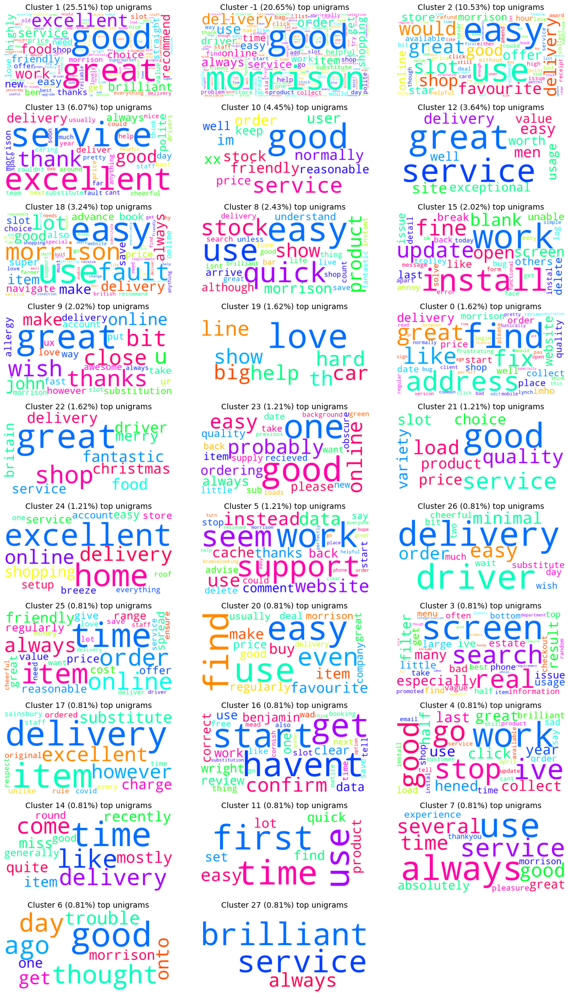

In [96]:
# Get topic clusters
mor_pos_df = get_topic_cluster('Morrisons', 'Positive', max_features=100, ngram_range=(2,5), eps=0.9, min_samples=2)

# Count the unique number of clusters
num_cluster = len(set(mor_pos_df['topic_cluster']))
print('\033[1m' + f'{num_cluster} clusters were successfully created')

# Get cluster size
mor_pos_cluster_size_df = compute_cluster_size(mor_pos_df)

# Show all clusters
mor_pos_all_clusters = get_all_cluster_list(mor_pos_cluster_size_df)
mor_pos_all_cluster_size = get_all_cluster_size_list(mor_pos_cluster_size_df)

get_wordclouds('Morrisons positive', mor_pos_df, mor_pos_all_clusters, mor_pos_all_cluster_size, 14, 'hsv_r')

In [97]:
# Create a dict of cluster name and cluster number
mor_pos_cluster_name = {'Good, excellent':[1,10],
                       'Easy to use':[2,11,20,18,8,23],
                       'Excellent service':[13,12,27,7,21],
                       'Punctual delivery':[14,17,25,24,26,22],
                       'App crash':[3,5,15]}

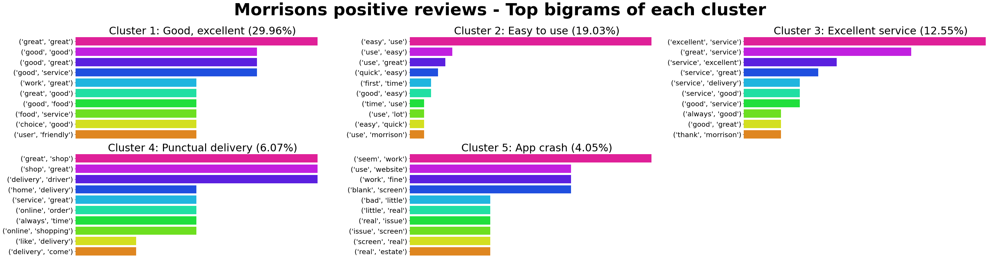

In [98]:
# Append cluster name into the original dataframe
mor_pos_df['cluster_name'] = get_cluster_name(mor_pos_df, mor_pos_cluster_name)
mor_pos_cluster_size_df = get_cluster_size_df(mor_pos_df, top_n_cluster=50)

# Get top topic clusters
mor_pos_top_topic_cluster = get_top_cluster_list(mor_pos_cluster_size_df, top_n_cluster=20)
mor_pos_top_topic_cluster_size = get_top_cluster_size_list(mor_pos_cluster_size_df, top_n_cluster=20)

# Top topics
get_fdist_plots('Morrisons positive', mor_pos_df, mor_pos_top_topic_cluster,mor_pos_top_topic_cluster_size, 10, 'hsv_r')

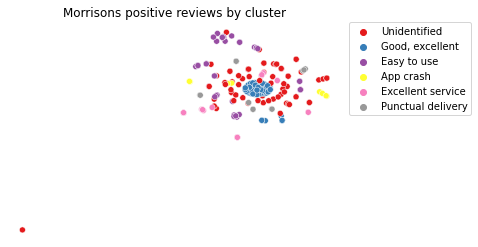

In [99]:
get_cluster_viz(mor_pos_df, 'Morrisons', 'Positive', mor_pos_cluster_name, 'Set1', max_features=100, ngram_range=(2,5), eps=0.9, min_samples=2)